In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib as mpl
import geopandas as gpd
import os
import cmocean.cm as cmo
import rasterio
import rasterio.plot as rplt
import app
import string
from affine import Affine
from rasterio.io import MemoryFile
import matplotlib.dates as mdates
import matplotlib.ticker as ticker
from shapely.geometry import Point

# 0. Import

In [42]:
data_folder = r"D:\[Code]\HydrofractureShackleton_2023\data"
data_dmg_folder = r"D:\[Code]\HydrofractureShackleton_2023\data-dmg"
data_img_folder = r"D:\[Code]\HydrofractureShackleton_2023\data-img"
figure_folder = r"D:\[Code]\HydrofractureShackleton_2023\figures"

In [97]:
path = os.path.join(data_folder, r"shackleton_hydrofractures.xlsx")
events_raw = pd.read_excel(path, index_col=0)
events_raw["geometry"] = gpd.GeoSeries.from_wkt(events_raw["geometry"])
events = gpd.GeoDataFrame(events_raw, geometry="geometry")  # type: ignore
events.set_crs("EPSG:4326", inplace=True)
events.sort_values("lon", inplace=True)
events.reset_index(drop=True, inplace=True)
events.to_crs("EPSG:3031", inplace=True)
events["label"] = list(string.ascii_uppercase)[: len(events)]
events["summer"] = [app.determine_antarctic_summer(d) for d in events["date-0 vis"]]
events["volume-1 m^3"] = np.nan_to_num(x=events["volume-1 m^3"].values, nan=0)  # type: ignore

In [101]:
events.query("label == 'D'")

,lon,lat,lake,tile,date-0,sat-0,start-0,end-0,meandepth-0 m,volume-0 m^3,...,end-1,meandepth-1 m,volume-1 m^3,sat-1 vis,date-1 vis,comment,geometry,type,label,summer
3,97.781752,-66.594966,56,182,2018-12-26,S2,2018-12-21,2018-12-31,0.6336,80023.718262,...,2019-01-10,NaN,0.0,L8,2019-01-05,NaN,POINT (2553811.141 -349000.031),point,D,2018


In [98]:
optical_files = [
    f
    for f in os.listdir(data_img_folder)
    if f.endswith(".tif") and f.split("_")[0] == "Optical"
]
sar_files = [
    f
    for f in os.listdir(data_img_folder)
    if f.endswith(".tif") and f.split("_")[0] == "Draining"
]

In [106]:
keys = ["lat", "lon", "Timestamp", "satellite", "file"]
metas = []
for f in optical_files:

    meta_info = f.split("_")[6:9] + [f.split("_")[9].split(".")[0]]
    meta_info[0] = float(meta_info[0]) # type: ignore
    meta_info[1] = float(meta_info[1])  # type: ignore
    meta_info[2] = pd.Timestamp(int(meta_info[2]), unit="ms")  # type: ignore
    meta_info.append(f)
    meta = {
        k:v for k, v in zip(keys, meta_info)
    }
    metas.append(meta)
optical = pd.DataFrame(metas)
optical["geometry"] = optical.apply(
    lambda row: Point(row["lon"], row["lat"]), axis=1
)
optical = gpd.GeoDataFrame(optical, geometry="geometry")
optical.set_crs("EPSG:4326", inplace=True)
optical.to_crs("EPSG:3031", inplace=True)
optical.sort_values("lon", inplace=True)
optical.reset_index(drop=True, inplace=True)
optical["lat round"] = optical["lat"].round(2)

temp_events = events.copy()
temp_events["lat round"] = events["lat"].round(2)
print()
combined = pd.merge(
    optical, temp_events, left_on="lat round", right_on="lat round", how="left"
)
combined.sort_values("label", inplace=True)
#combined.loc[combined["summer"] == 2018 | combined["summer"] == 2018, "label"] = "D"
combined.query("summer == 2018")

,lat_x,lon_x,Timestamp,satellite,file,geometry_x,lat round,lon_y,lat_y,lake,...,end-1,meandepth-1 m,volume-1 m^3,sat-1 vis,date-1 vis,comment,geometry_y,type,label,summer
85,-66.357776,98.870357,2019-12-31 02:46:28.222,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
73,-66.357776,98.870357,2019-12-15 02:26:33.052,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
79,-66.357776,98.870357,2020-01-30 02:46:25.439,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
71,-66.357776,98.870357,2019-12-11 02:46:27.435,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
81,-66.357776,98.870357,2020-02-13 02:26:33.662,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
69,-66.357776,98.870357,2020-03-14 02:26:36.403,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
83,-66.357776,98.870357,2020-03-04 02:26:35.992,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
77,-66.357776,98.870357,2020-01-14 02:26:32.774,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018
75,-66.357776,98.870357,2020-01-04 02:26:33.404,S2,Optical_clipped_HydrofracturingEvents_2020_Sha...,POINT (2573243.260 -401595.279),-66.36,98.84789,-66.359584,300,...,2019-02-11,0.53267,6711.637974,S1,2019-02-02,NaN,POINT (2573198.245 -400554.728),point,H,2018


C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 A


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


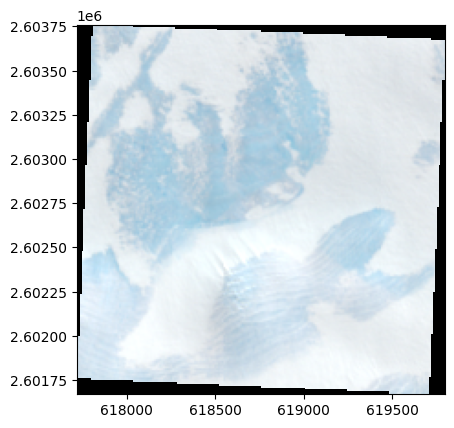

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


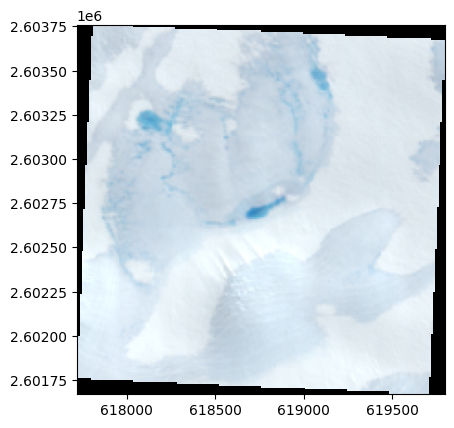

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


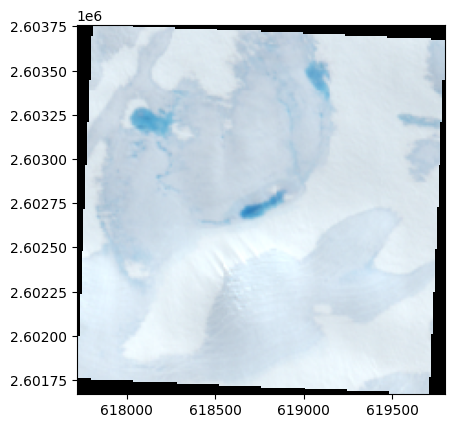

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


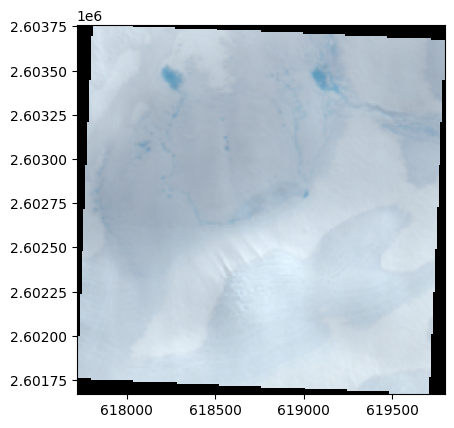

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


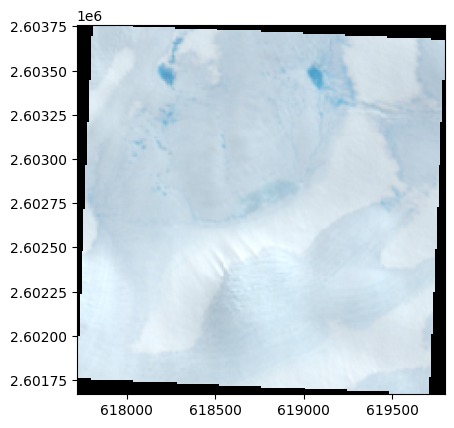

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


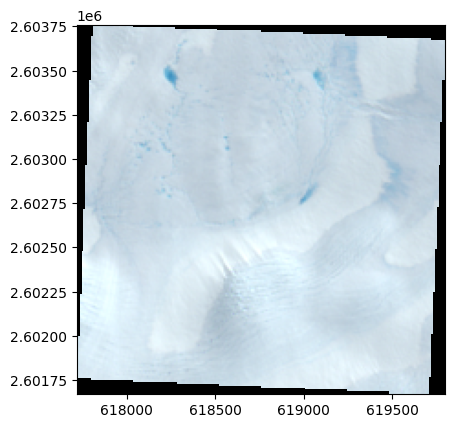

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


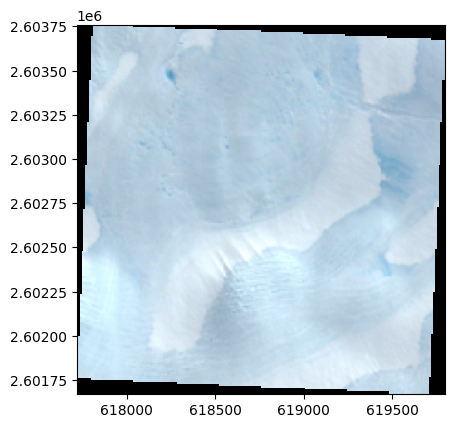

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


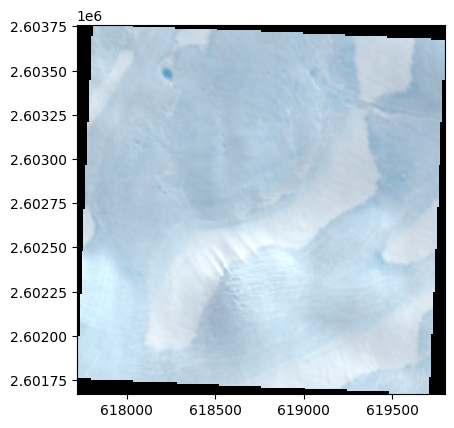

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 B


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


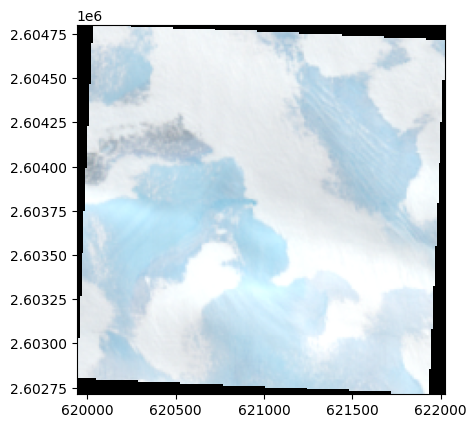

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


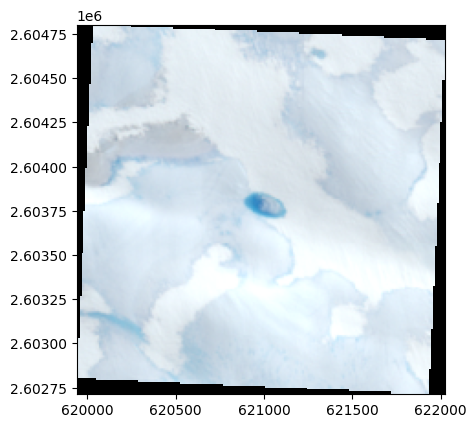

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


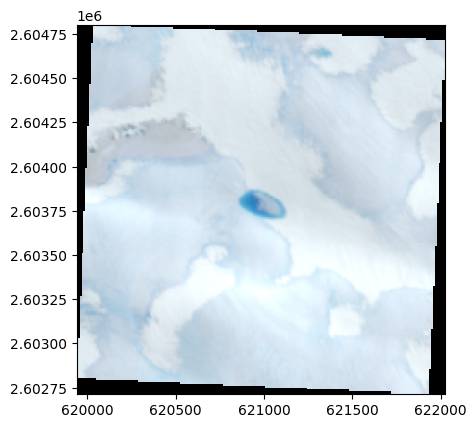

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


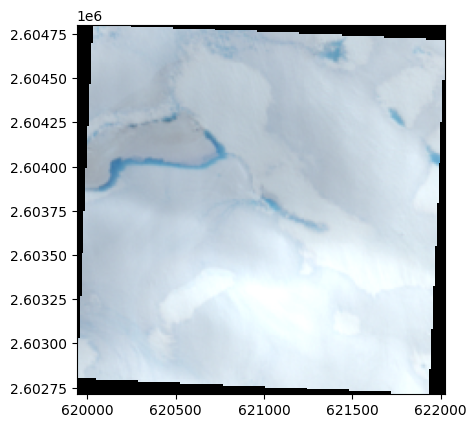

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


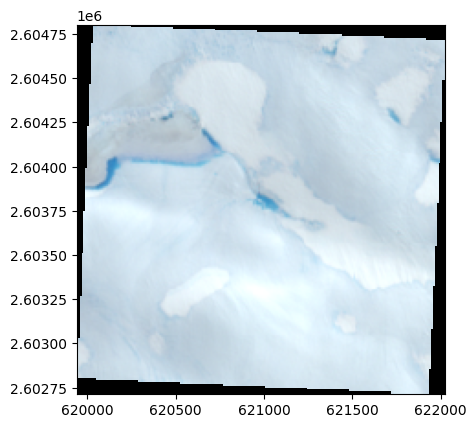

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


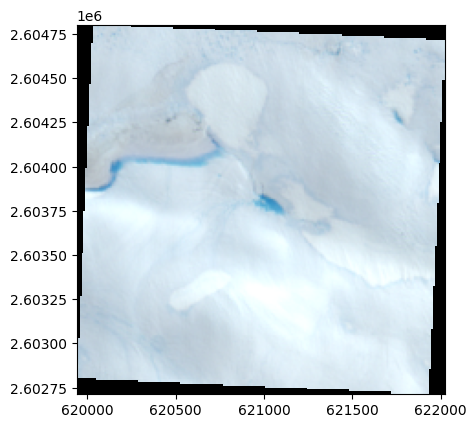

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


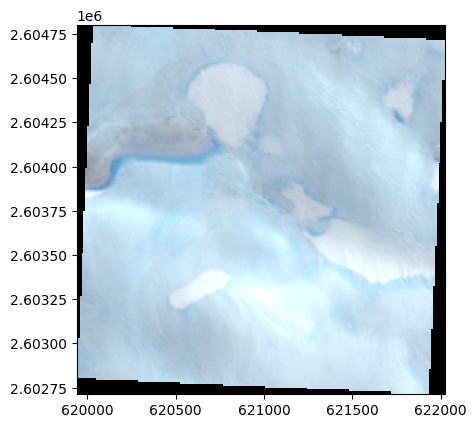

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


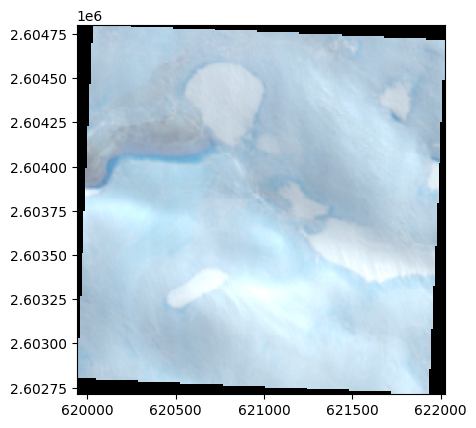

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 C


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


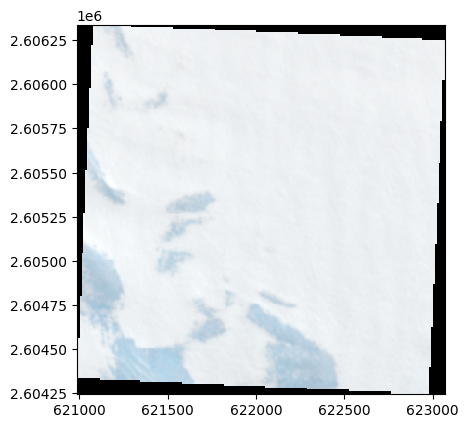

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


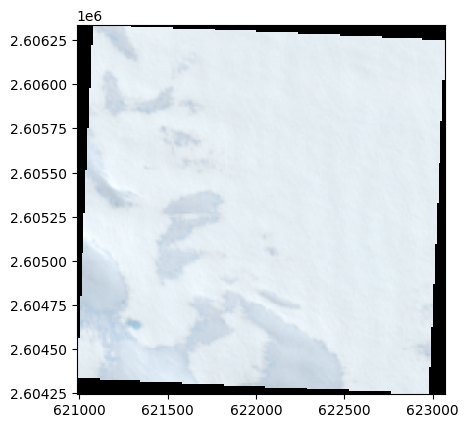

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


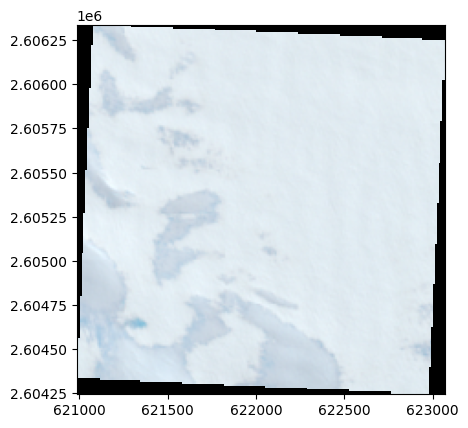

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


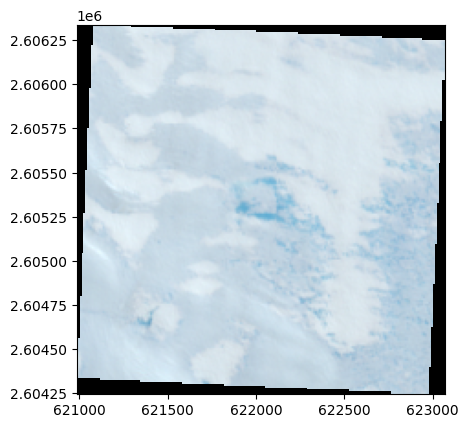

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


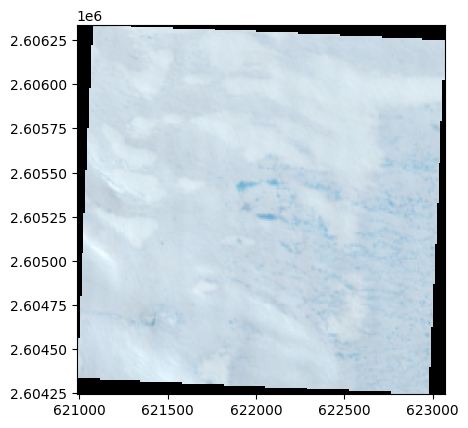

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


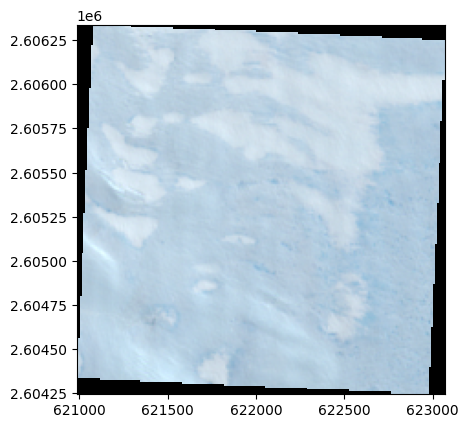

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


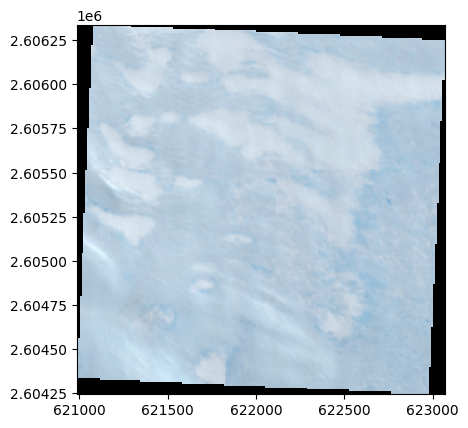

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 E


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


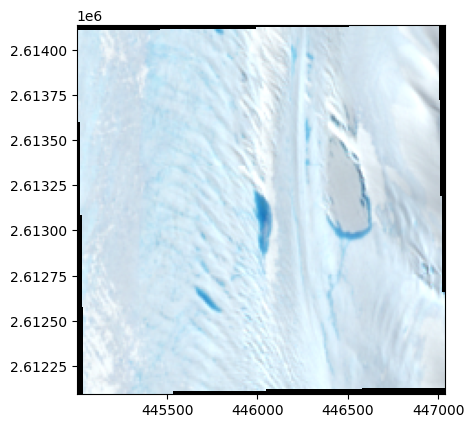

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


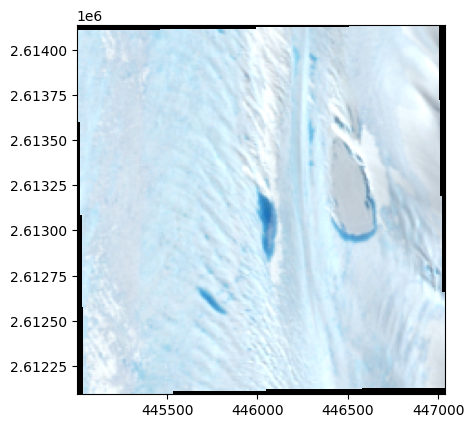

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


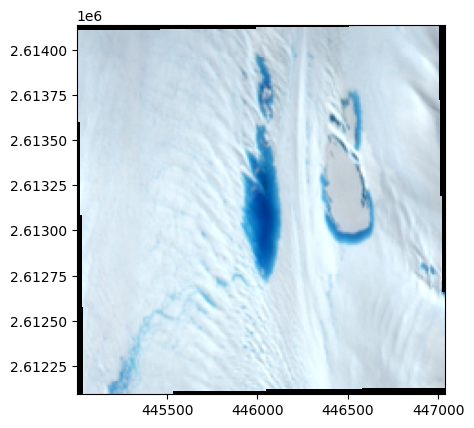

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


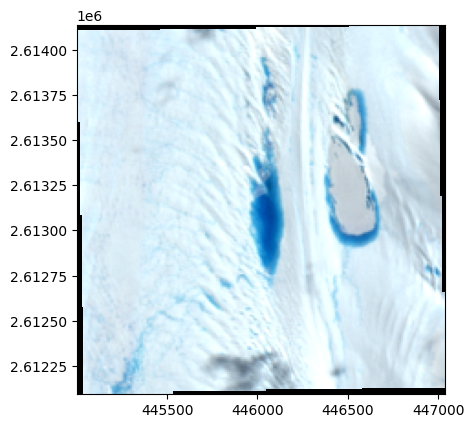

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


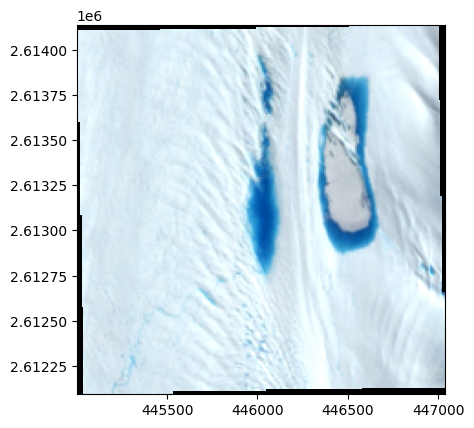

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


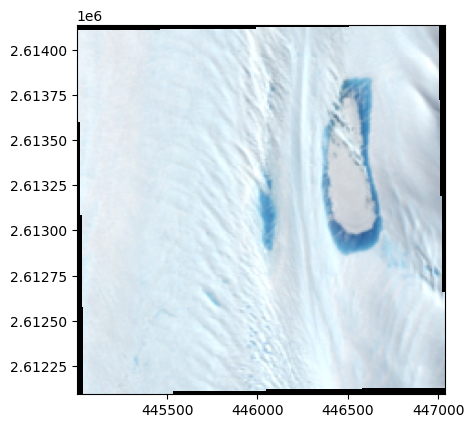

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


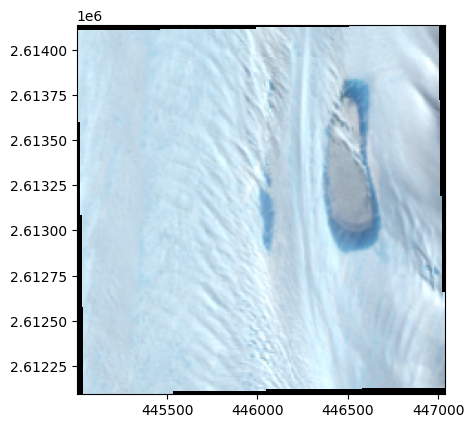

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


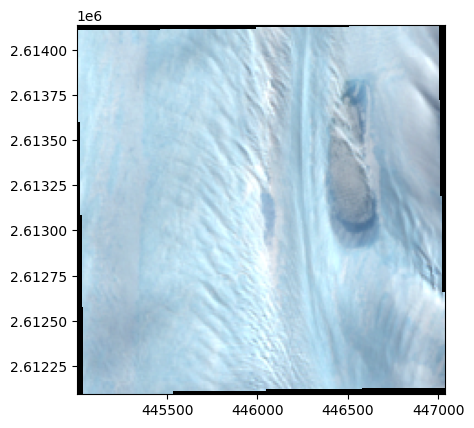

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


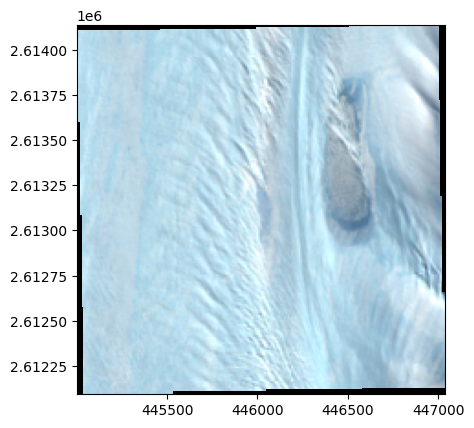

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


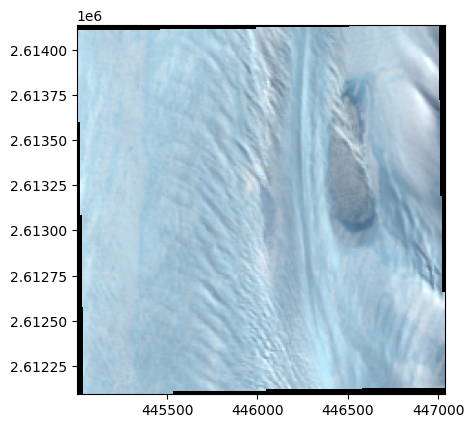

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


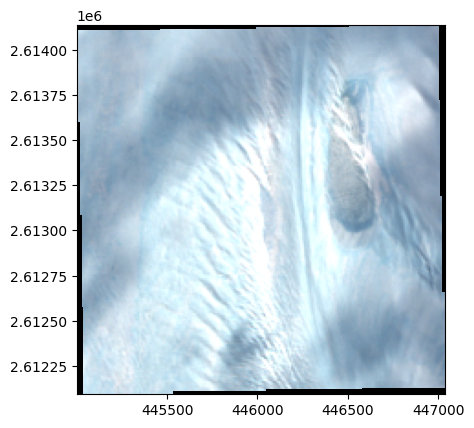

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 F


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


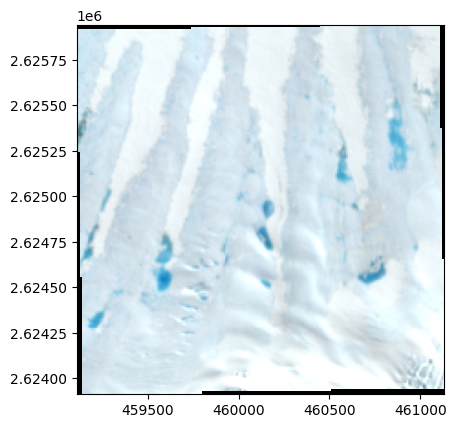

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


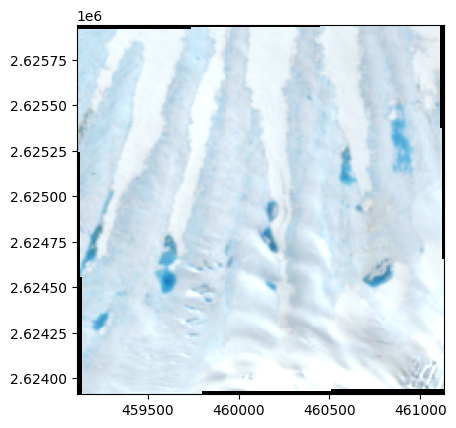

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


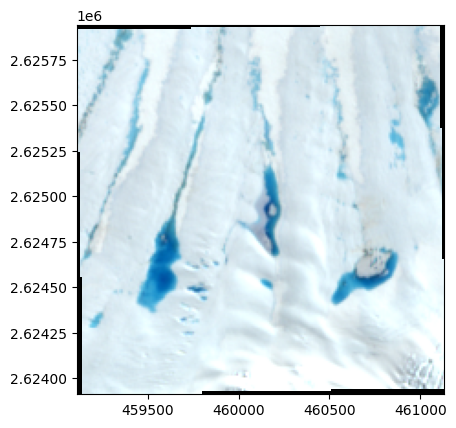

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


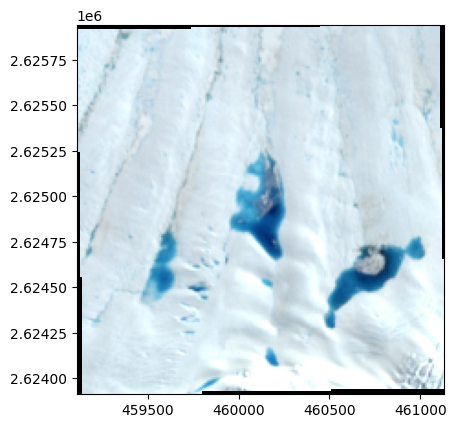

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


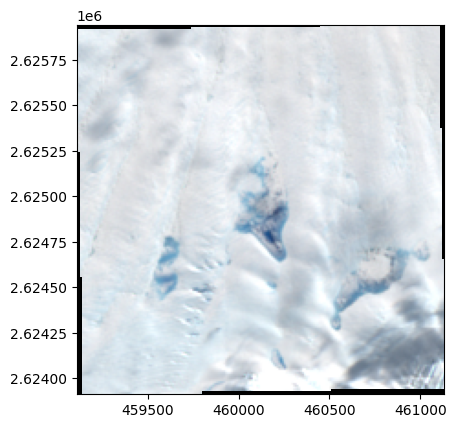

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


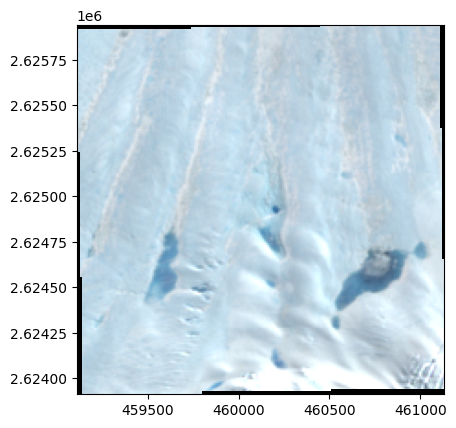

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


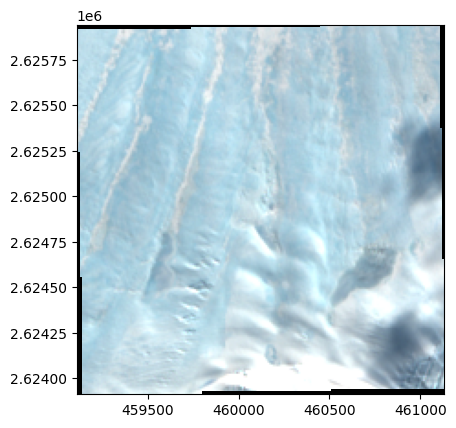

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


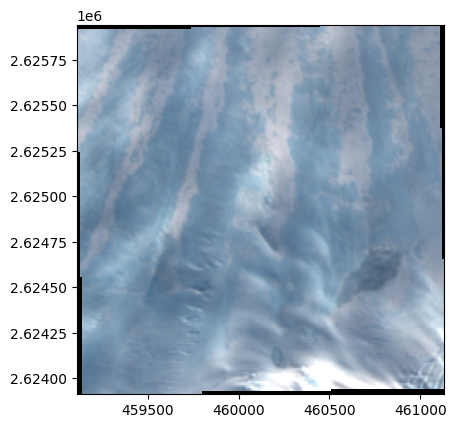

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 G


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


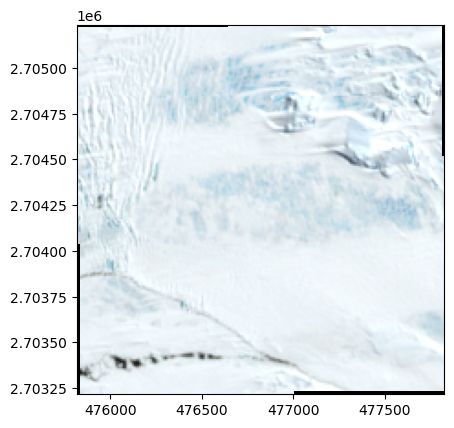

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


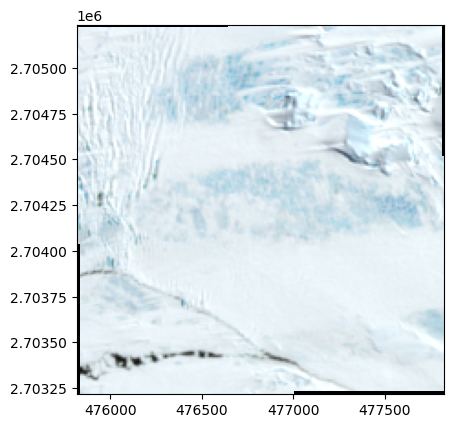

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


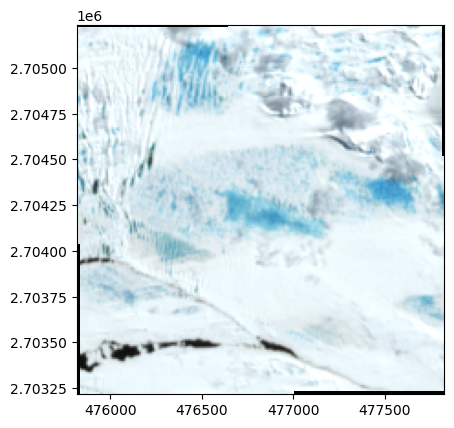

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


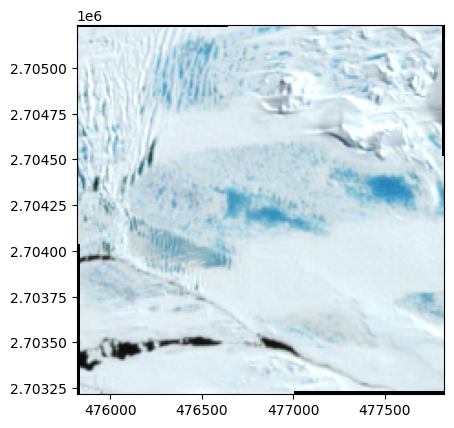

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


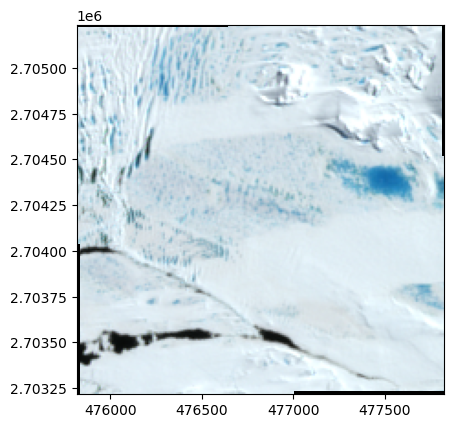

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


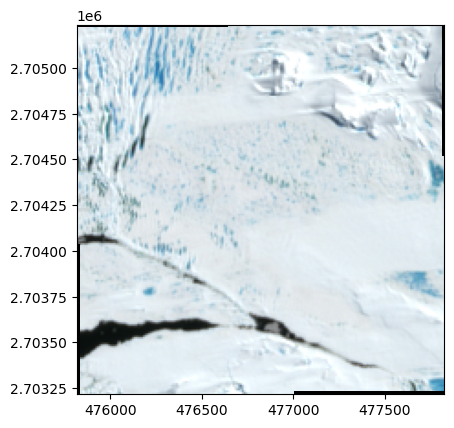

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


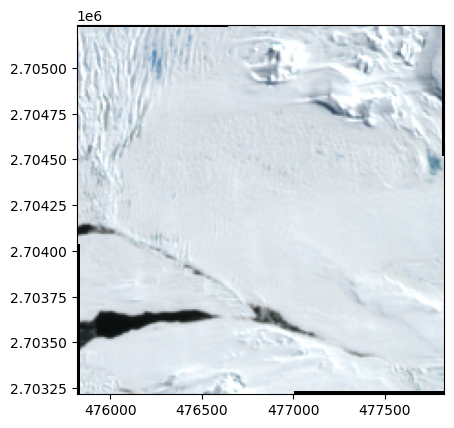

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 I


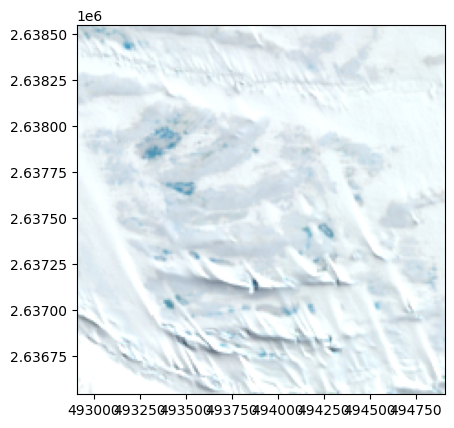

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


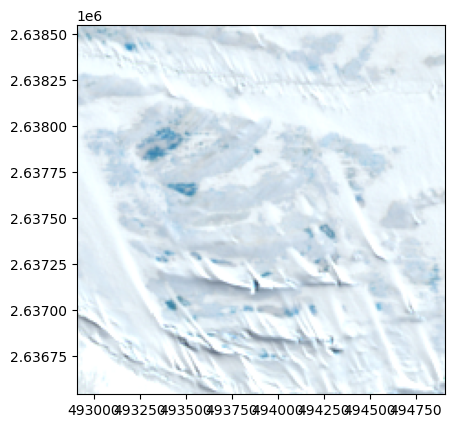

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


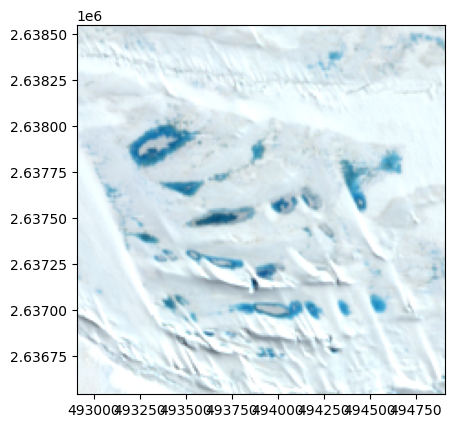

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


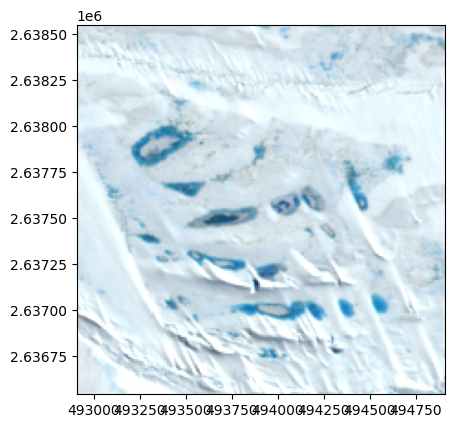

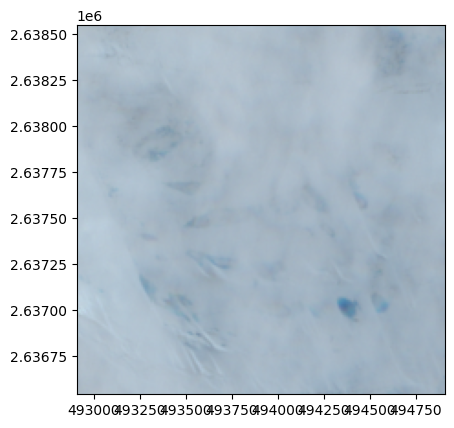

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


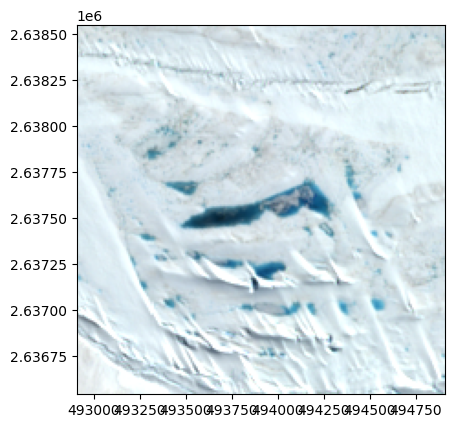

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


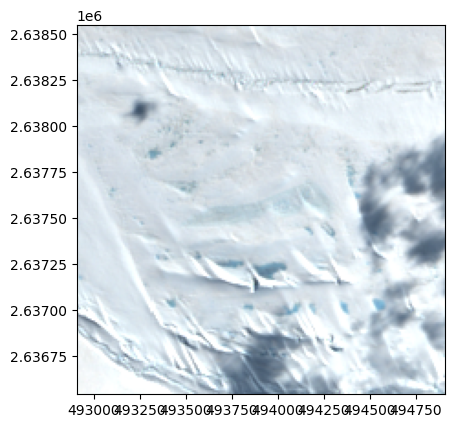

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


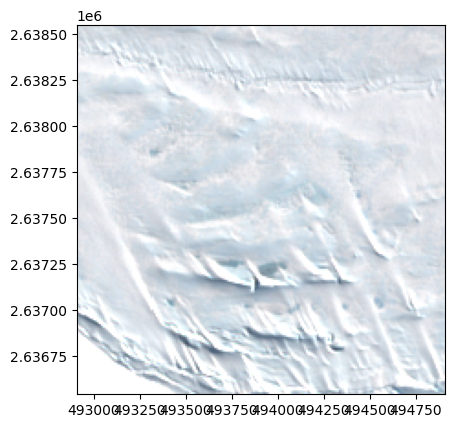

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


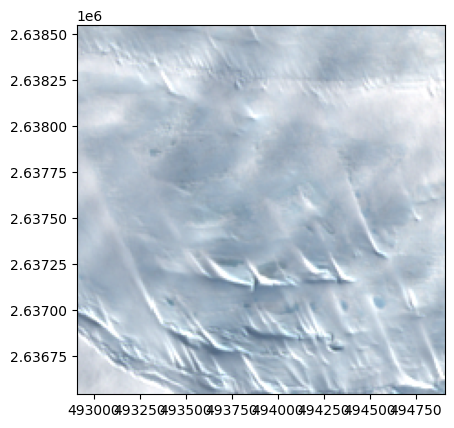

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


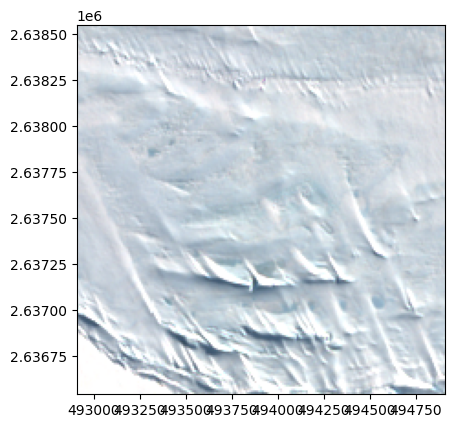

d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


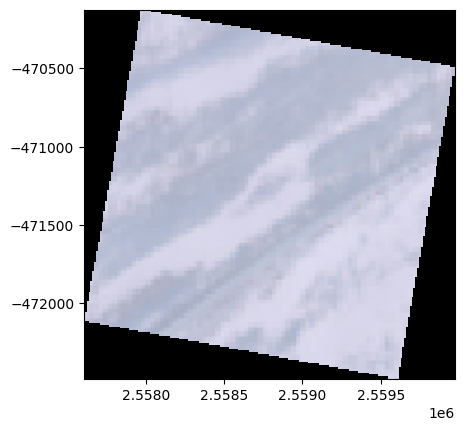

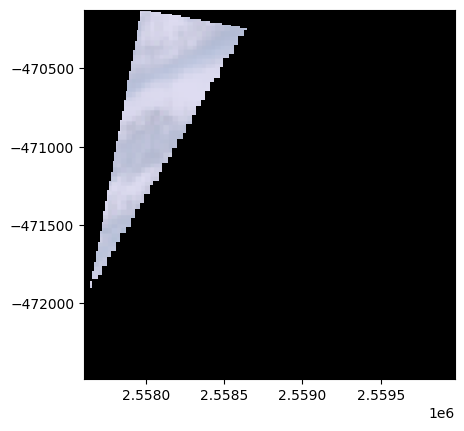

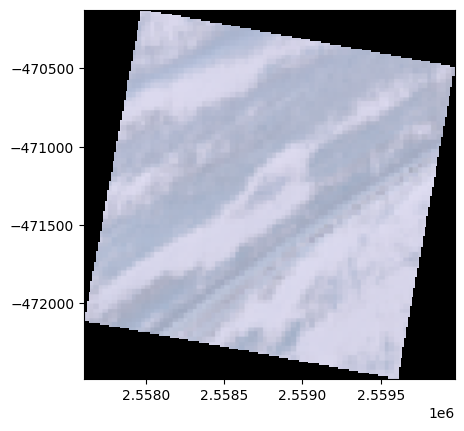

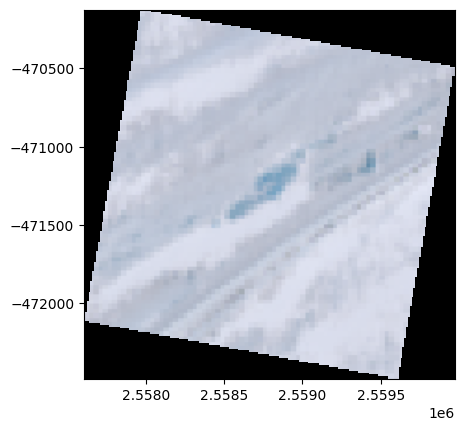

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


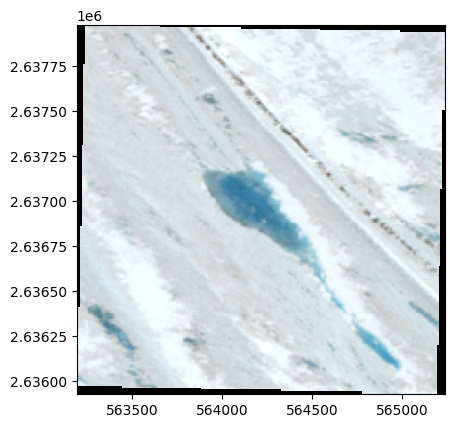

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


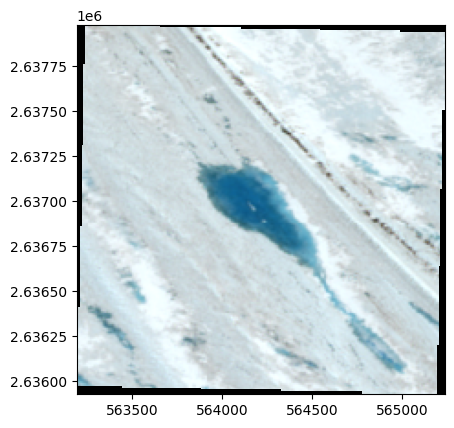

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


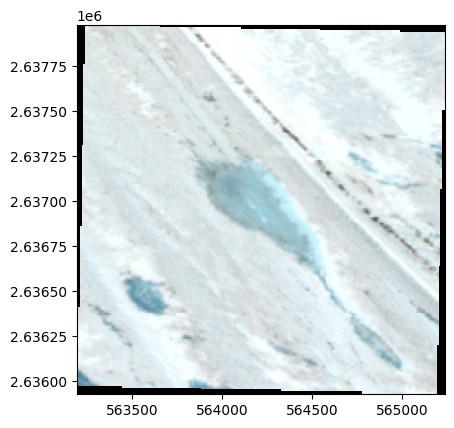

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


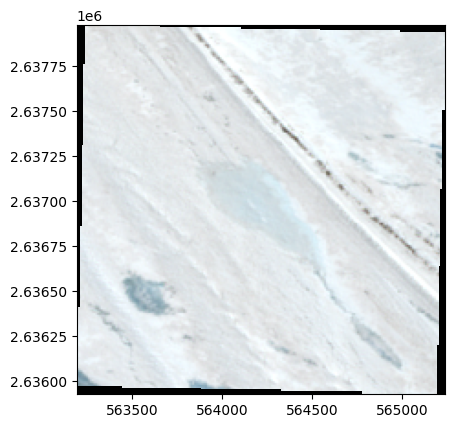

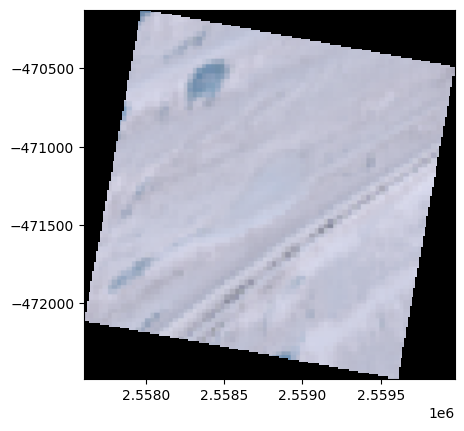

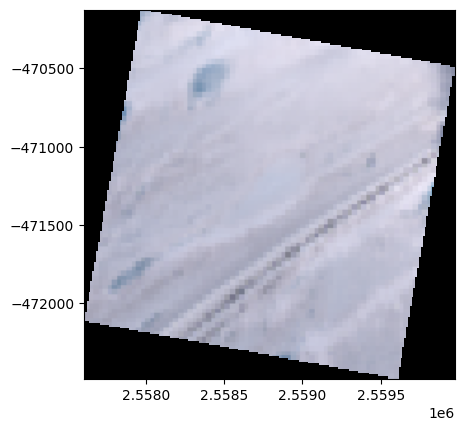

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


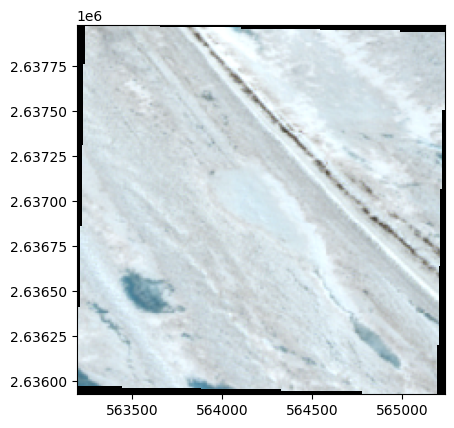

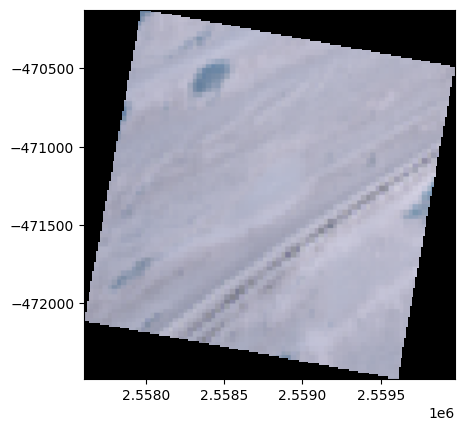

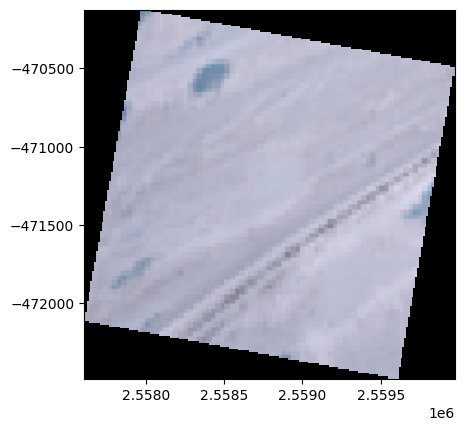

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


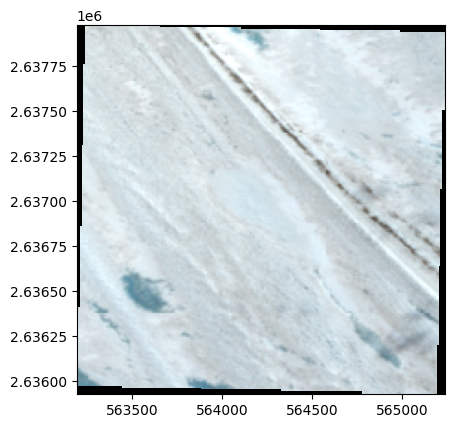

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


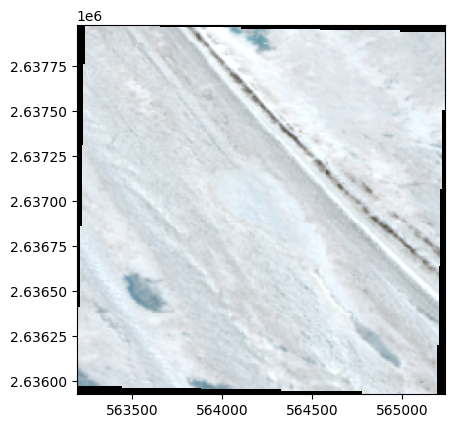

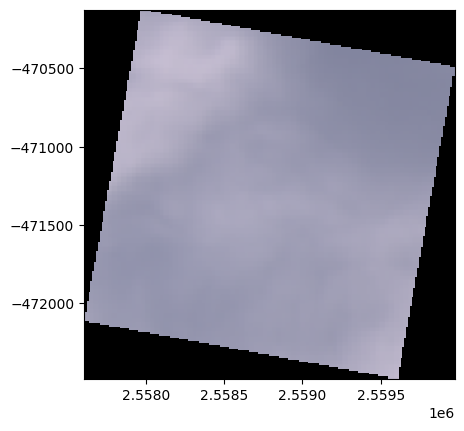

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


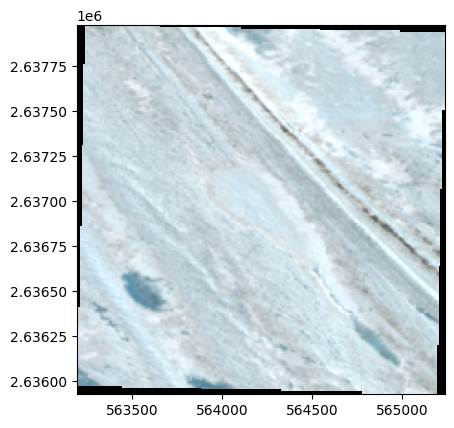

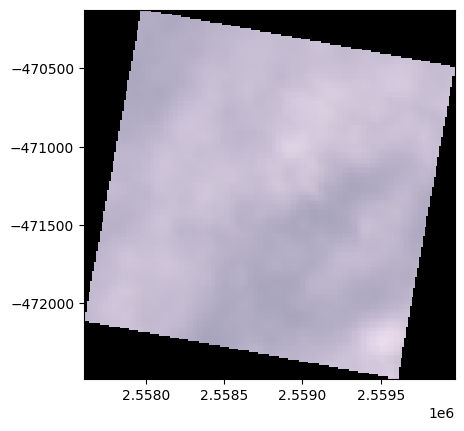

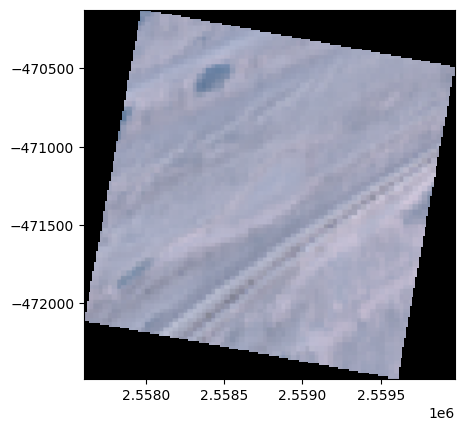

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


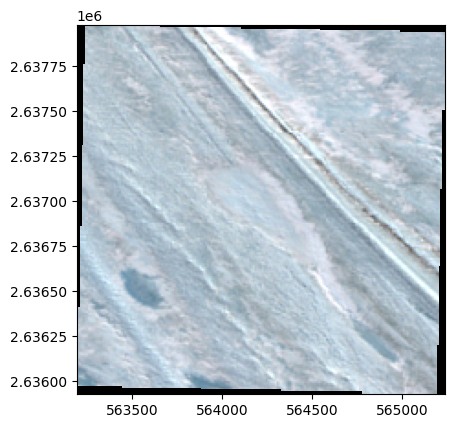

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 J


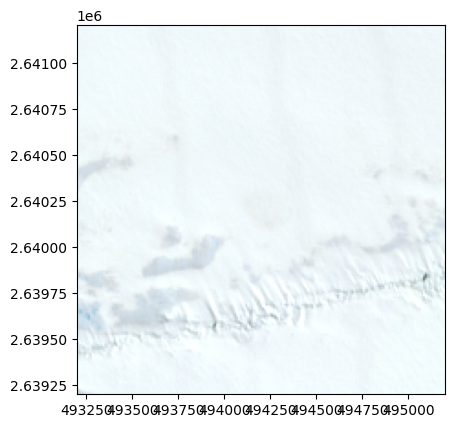

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


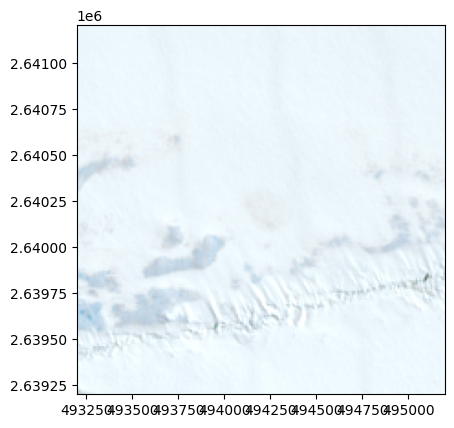

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


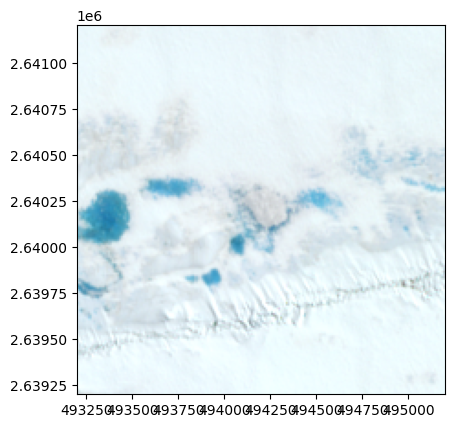

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


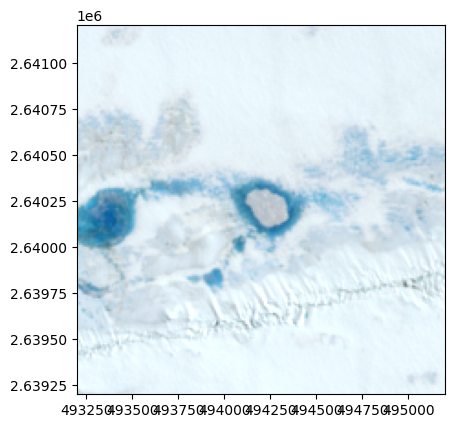

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


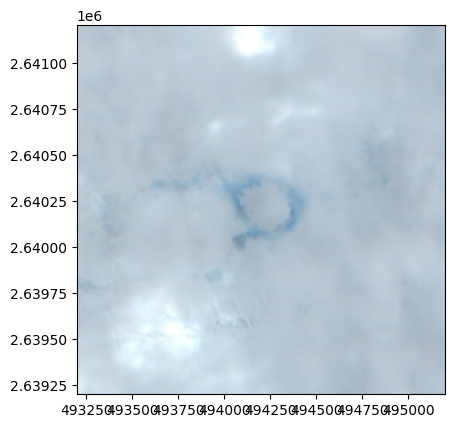

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


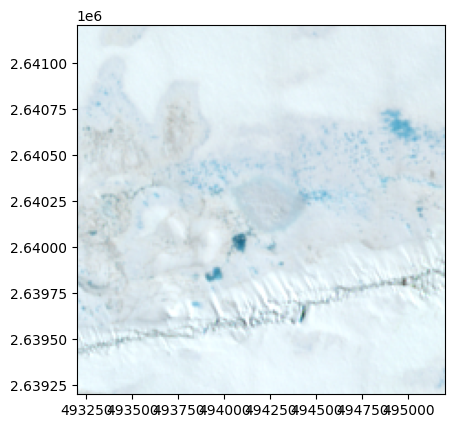

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


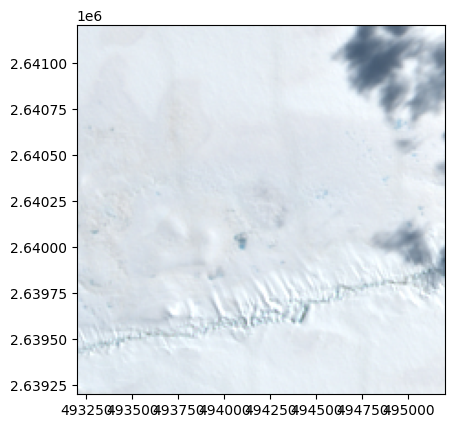

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


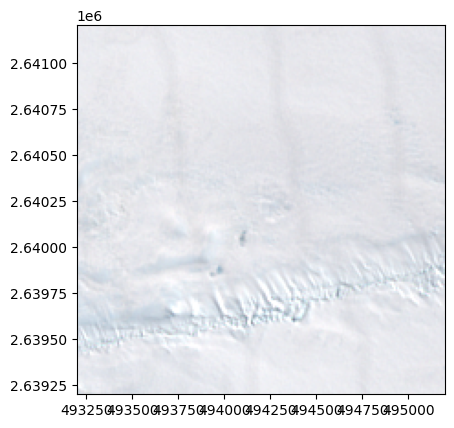

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


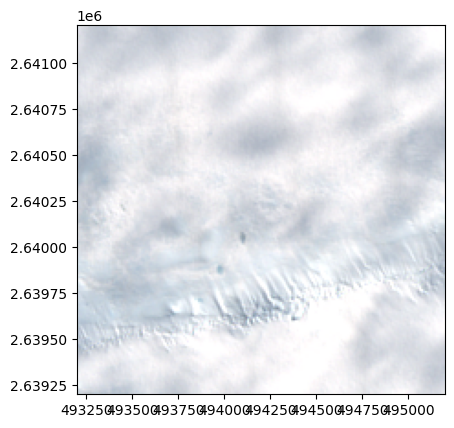

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 K


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


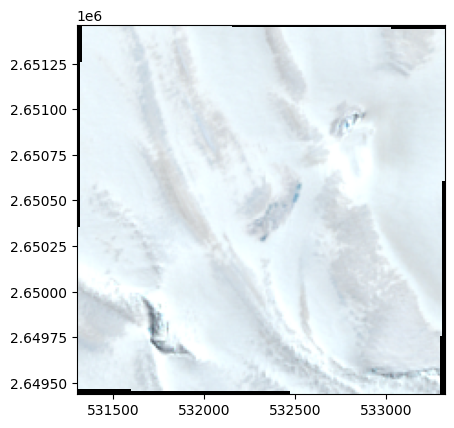

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


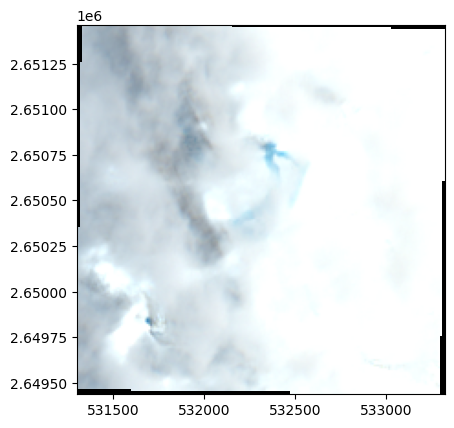

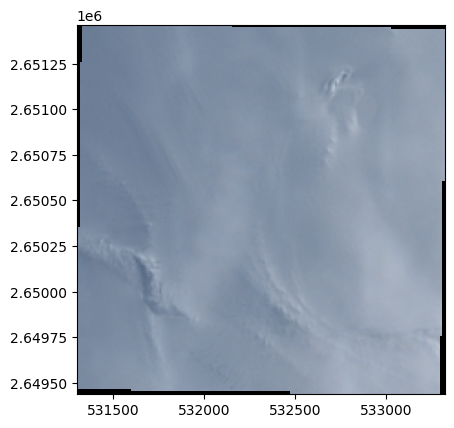

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 L


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


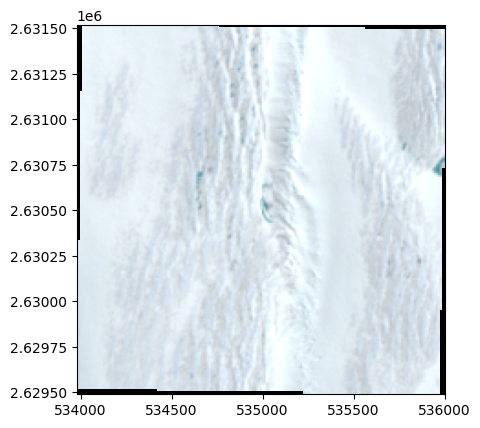

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


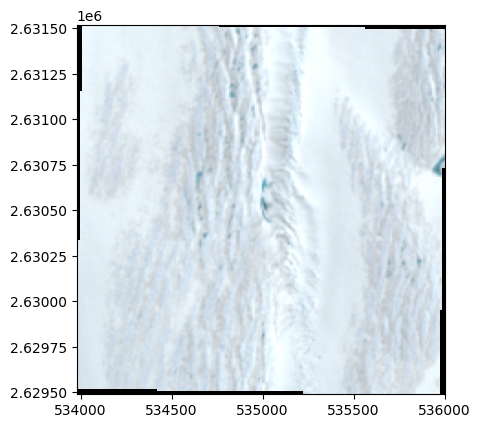

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


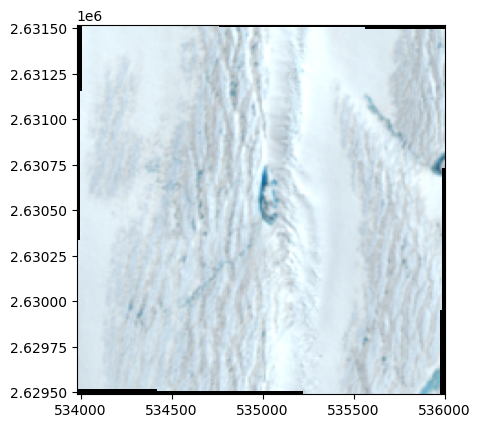

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


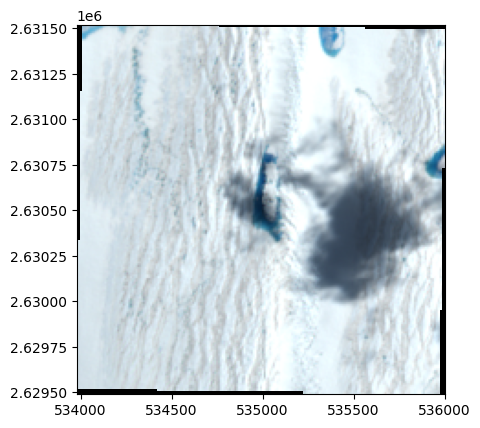

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


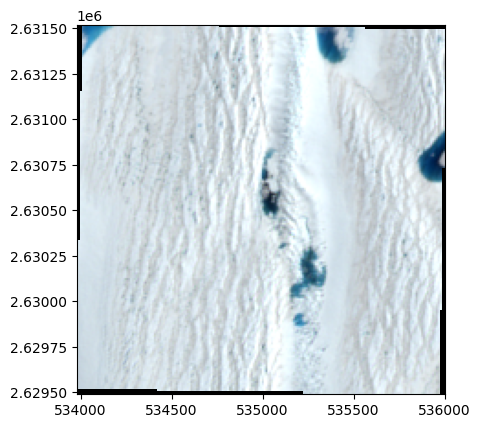

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


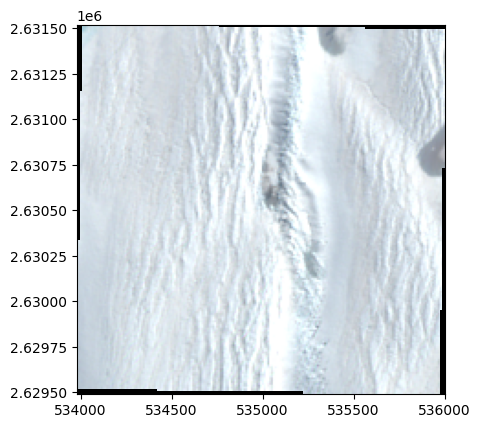

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


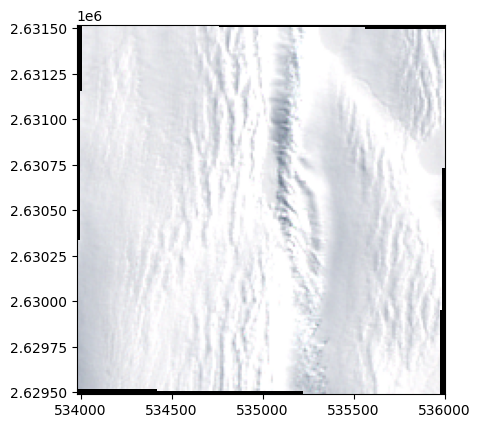

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


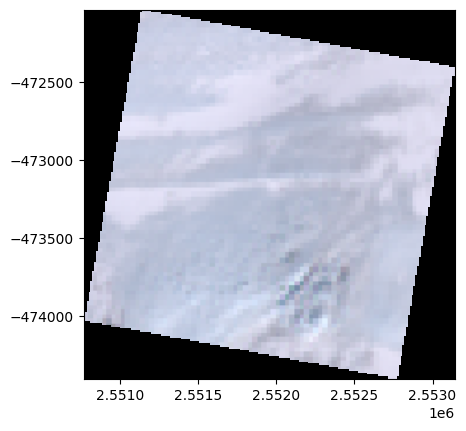

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


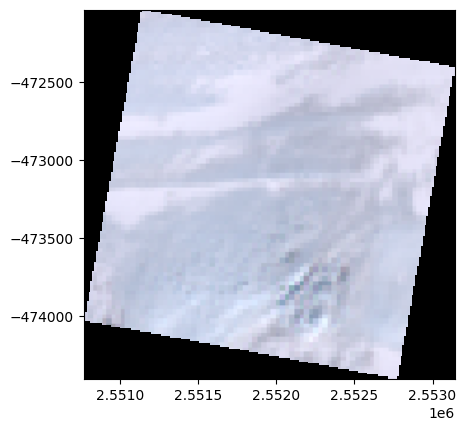

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


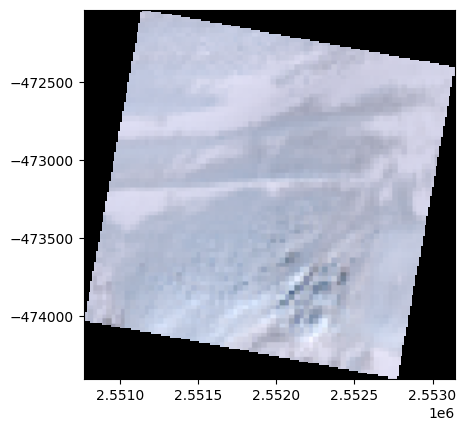

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


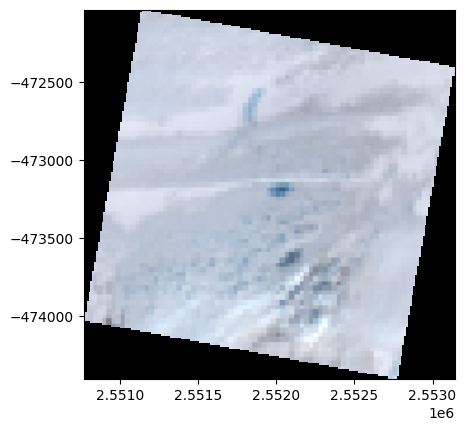

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


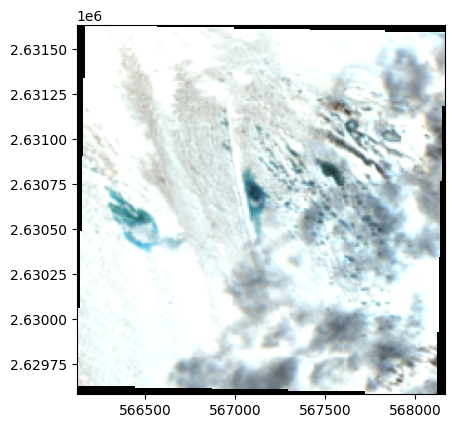

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


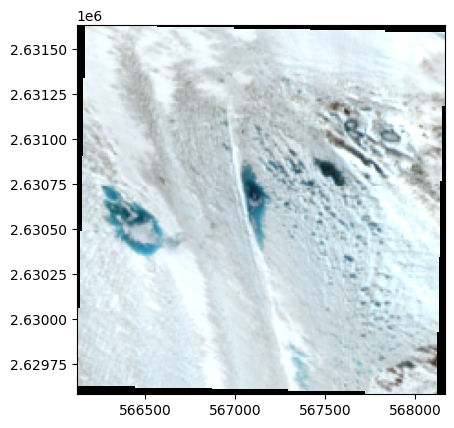

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


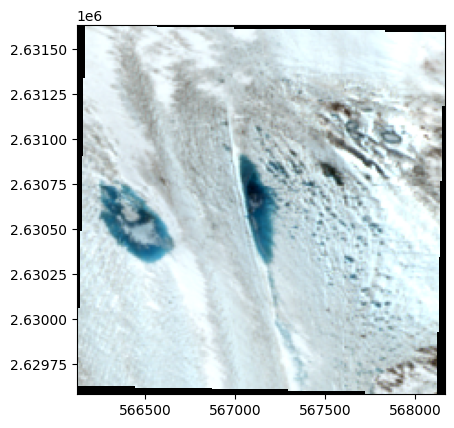

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


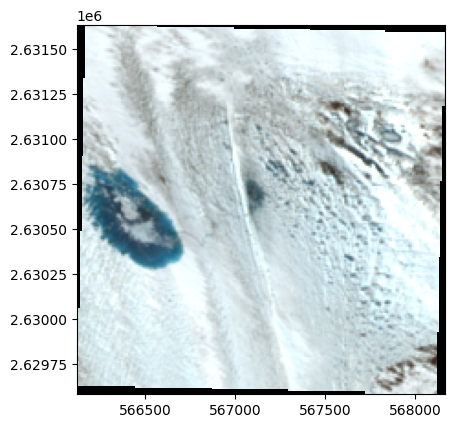

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


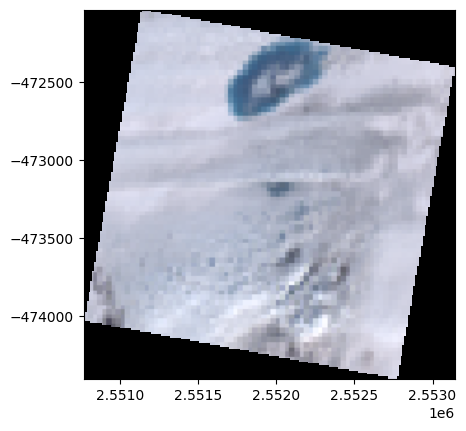

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


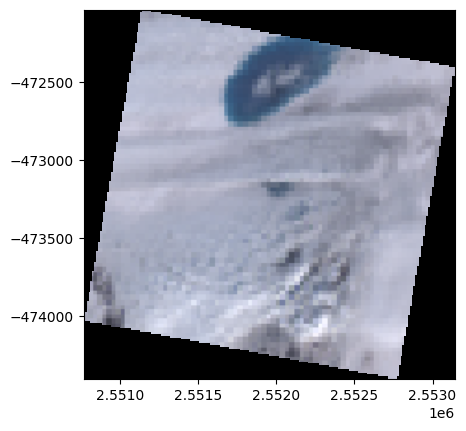

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


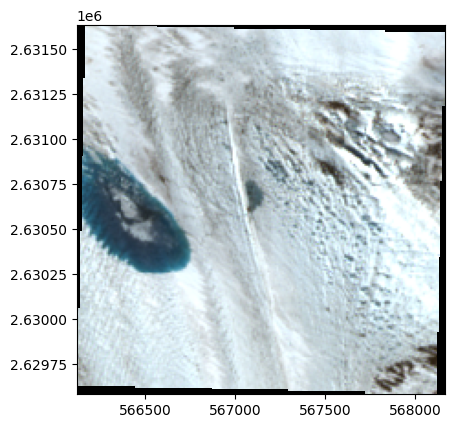

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


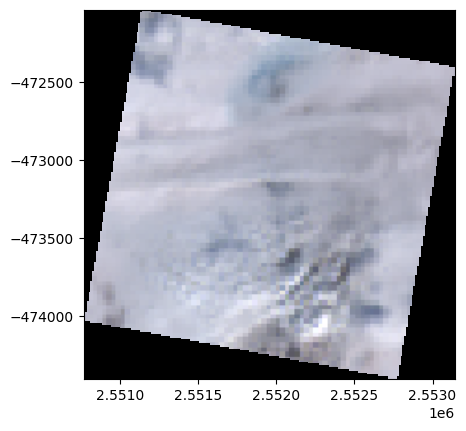

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


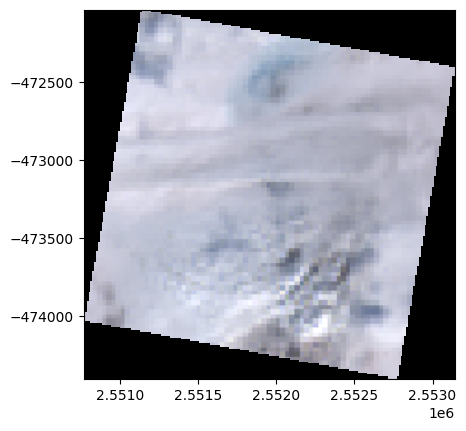

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


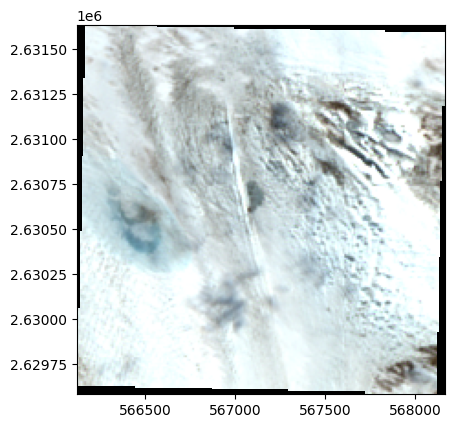

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


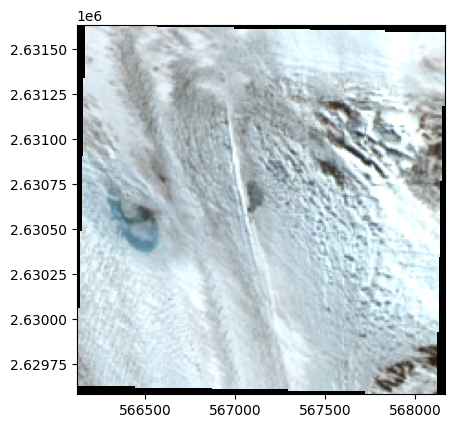

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


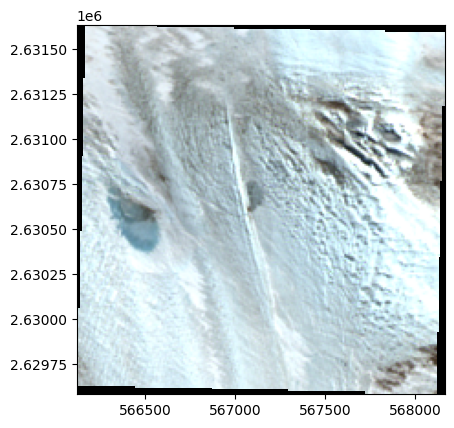

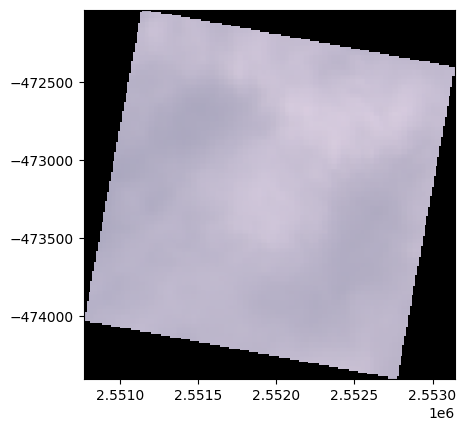

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


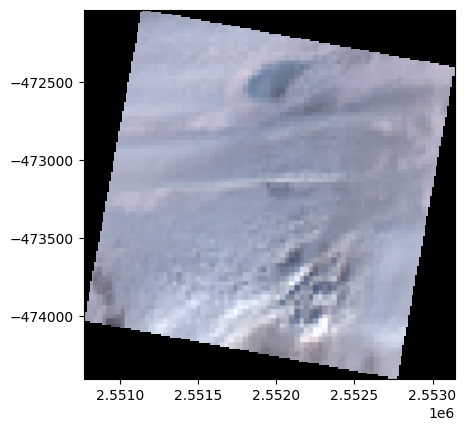

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


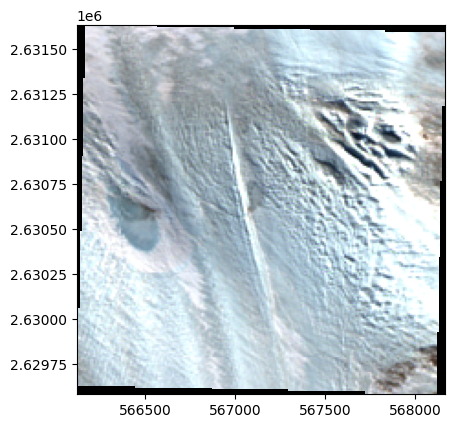

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 M


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


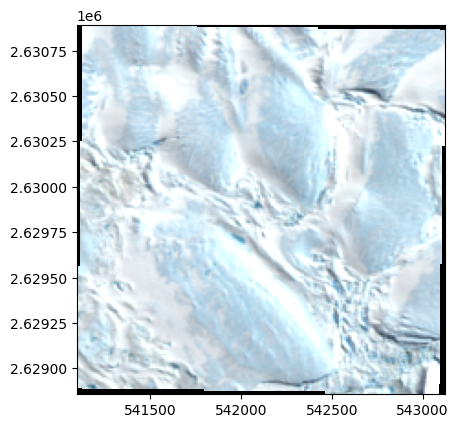

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


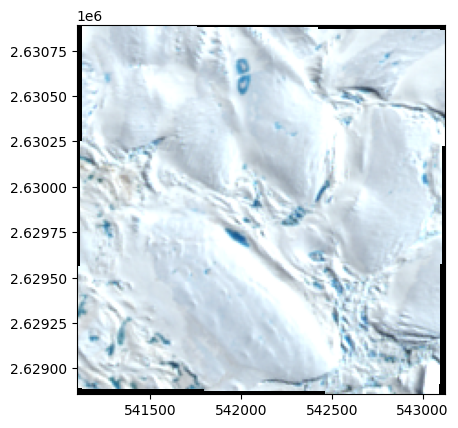

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


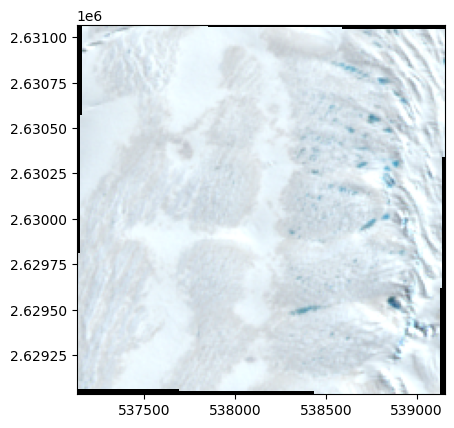

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


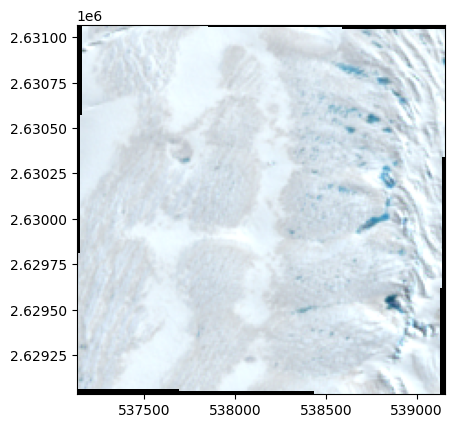

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


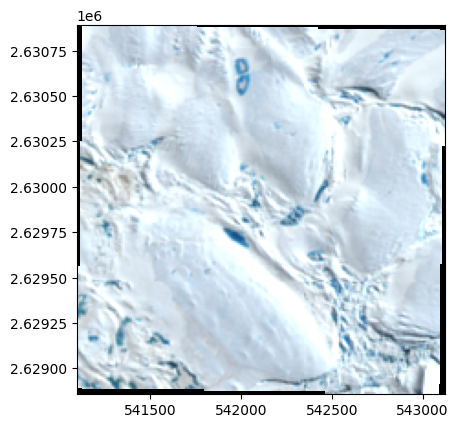

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


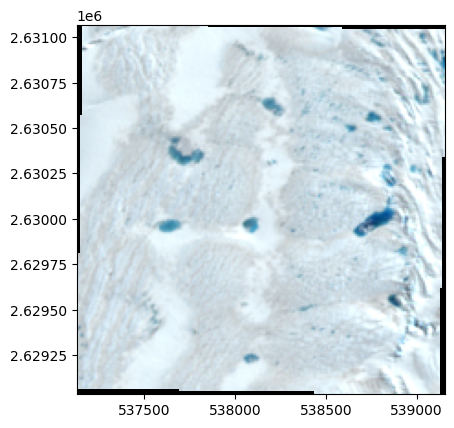

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


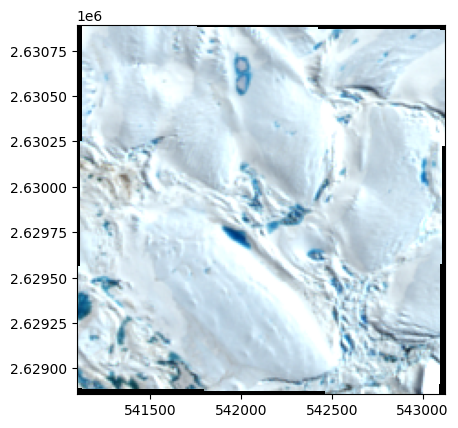

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


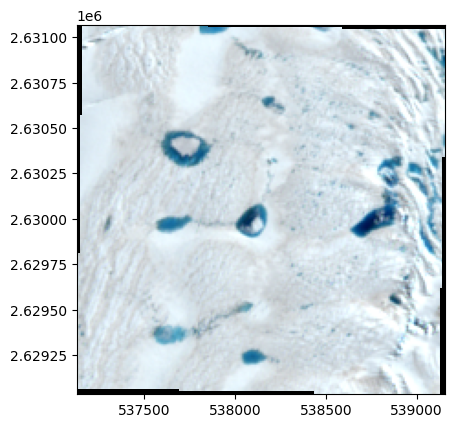

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


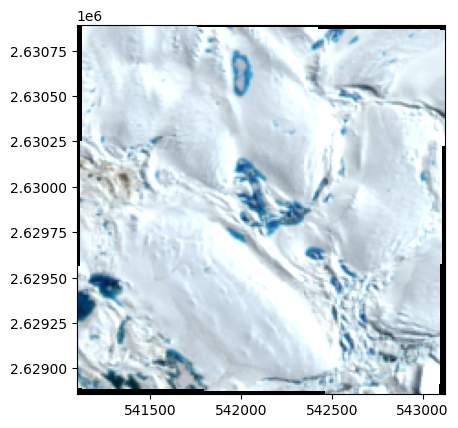

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


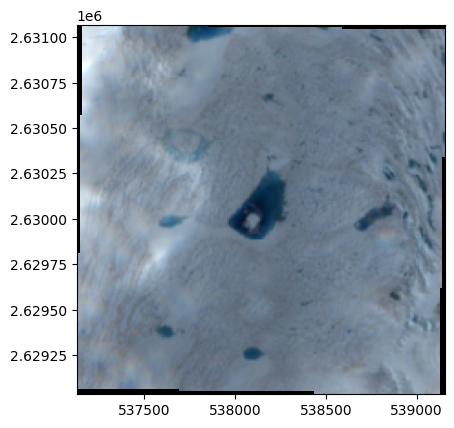

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


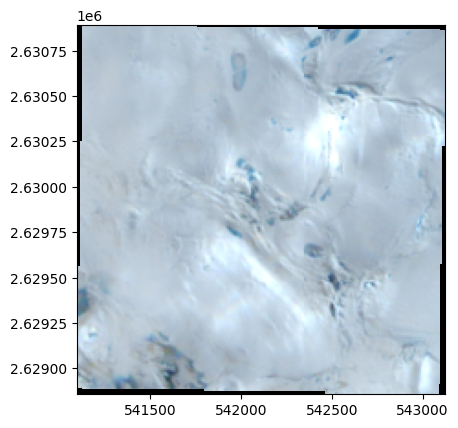

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


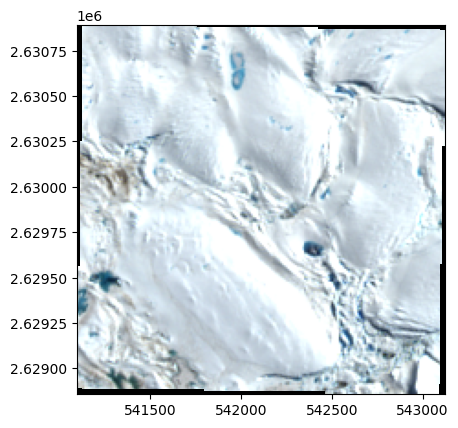

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


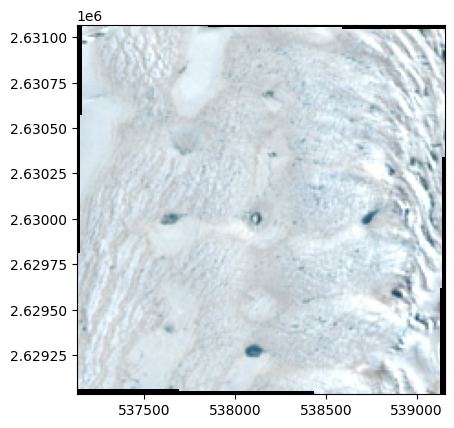

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


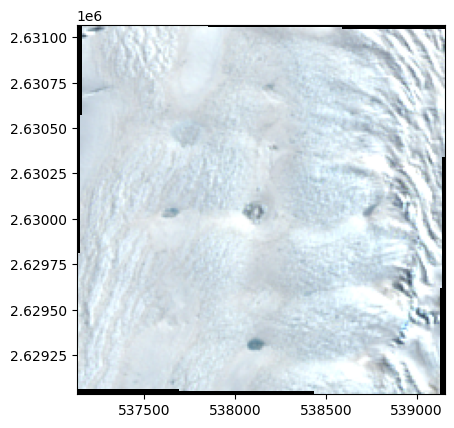

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


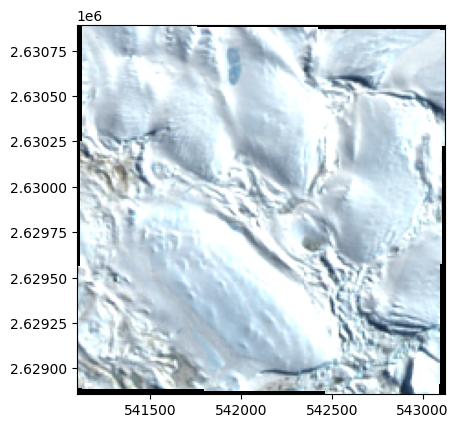

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


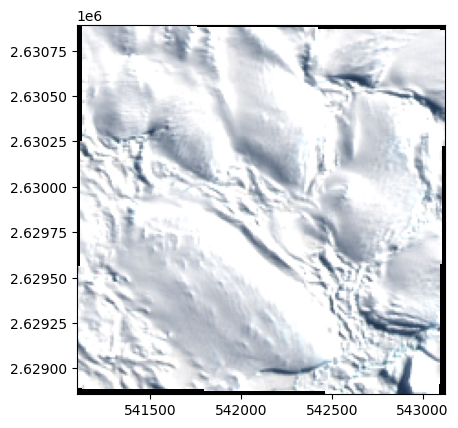

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


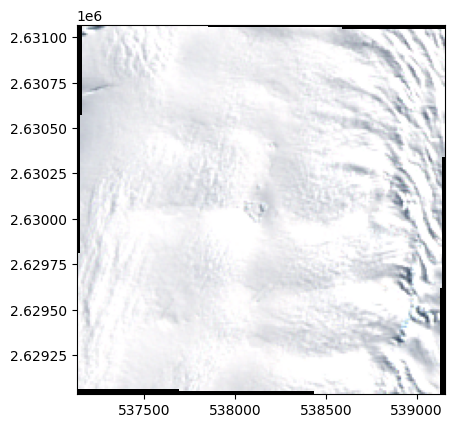

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 O


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


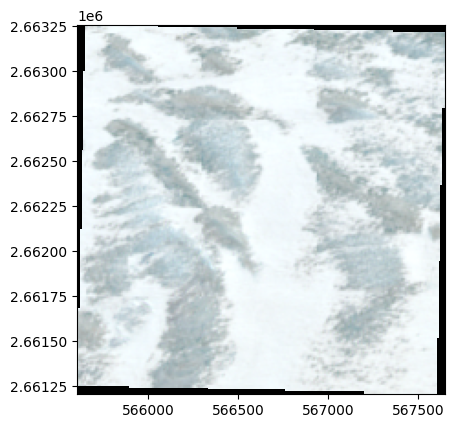

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


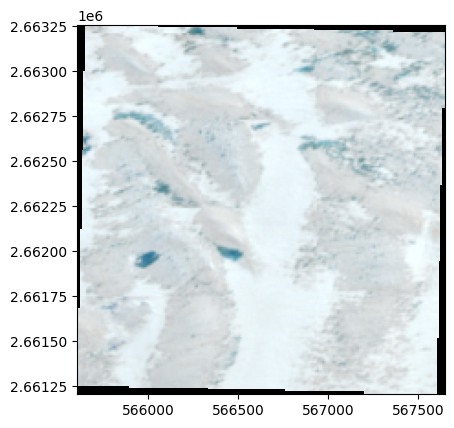

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


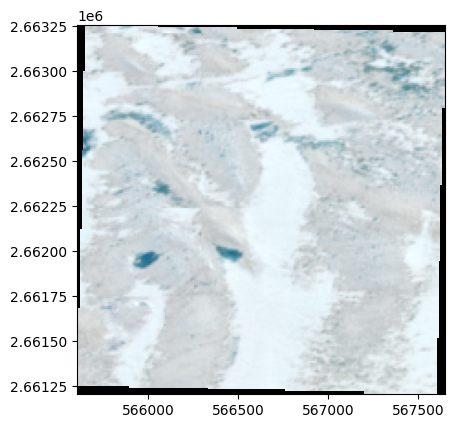

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


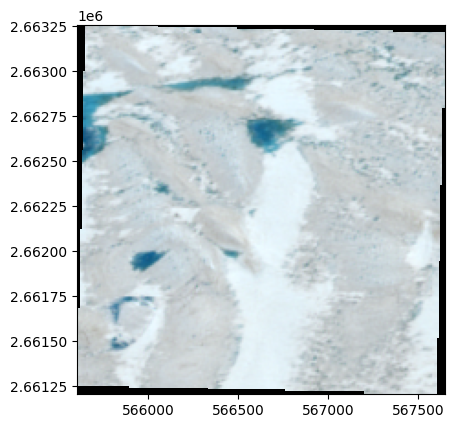

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


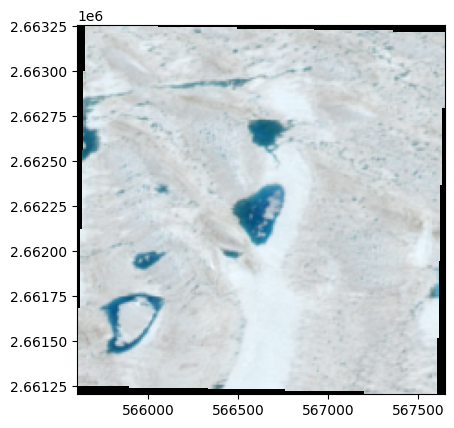

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


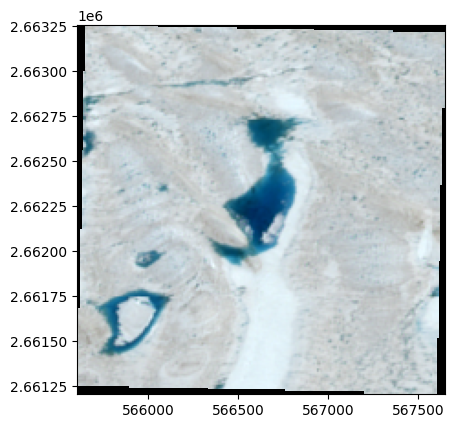

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


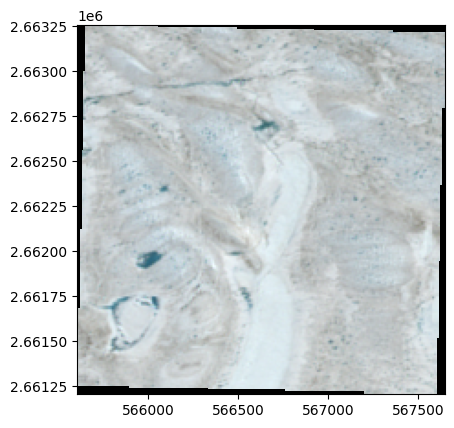

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


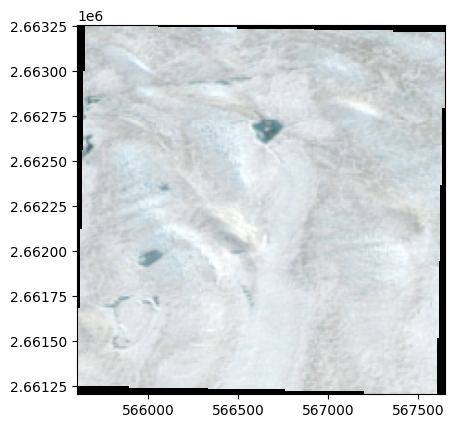

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


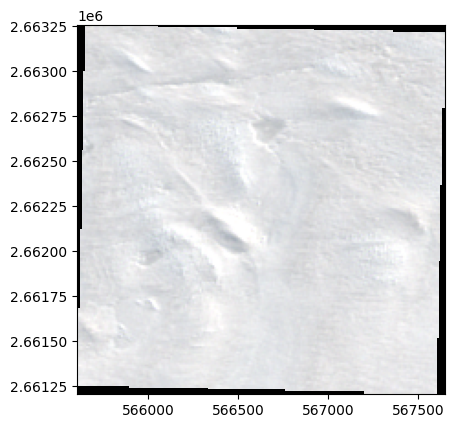

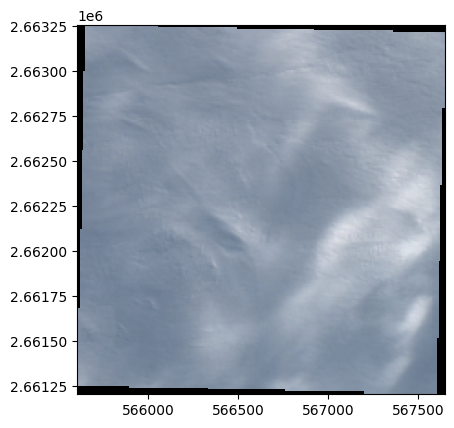

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 P


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


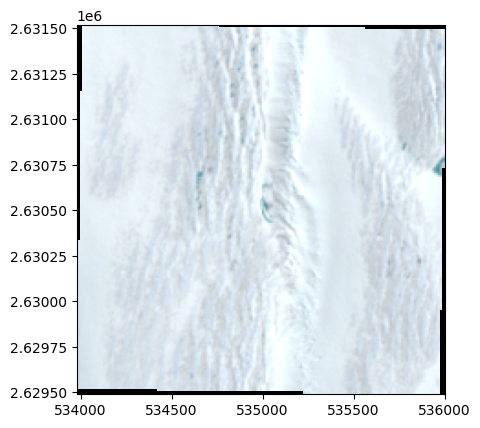

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


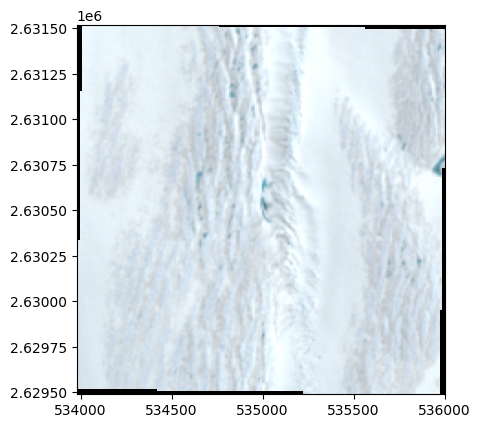

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


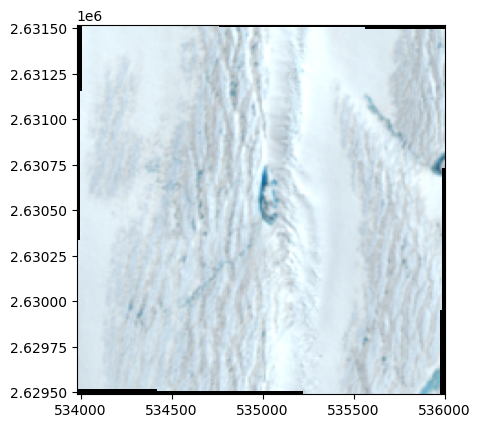

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


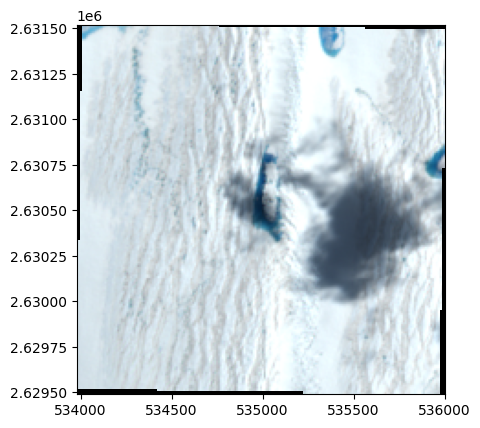

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


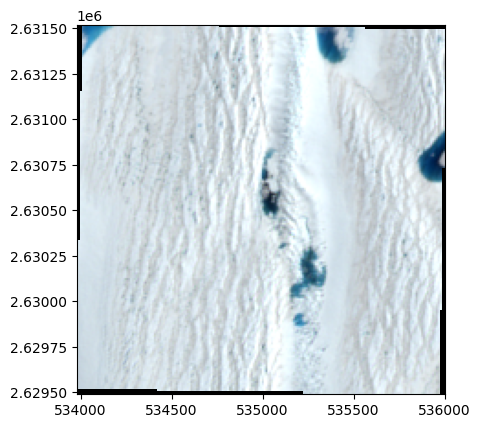

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


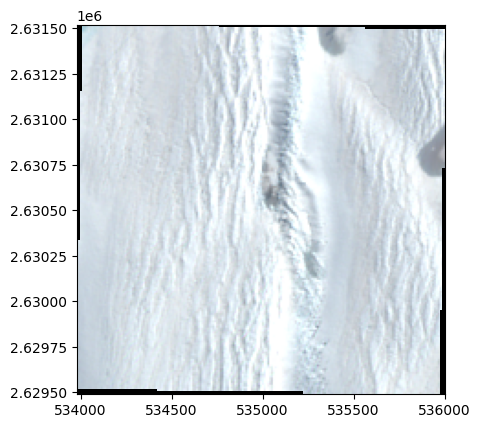

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


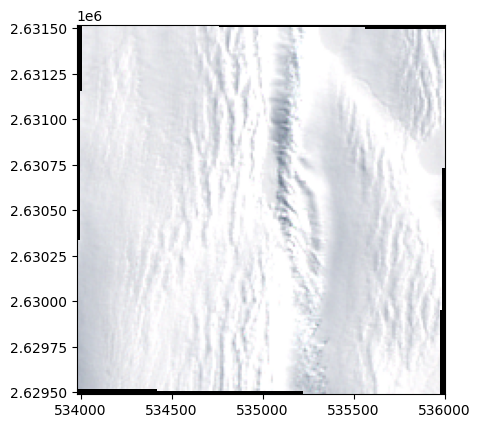

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


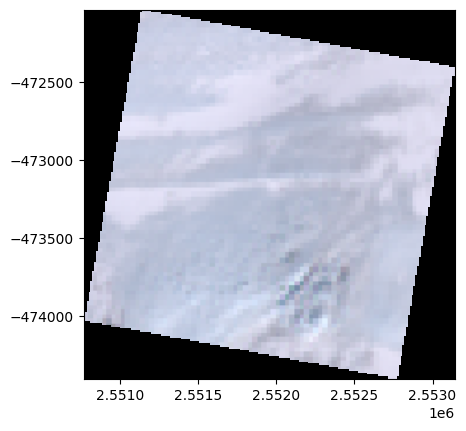

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


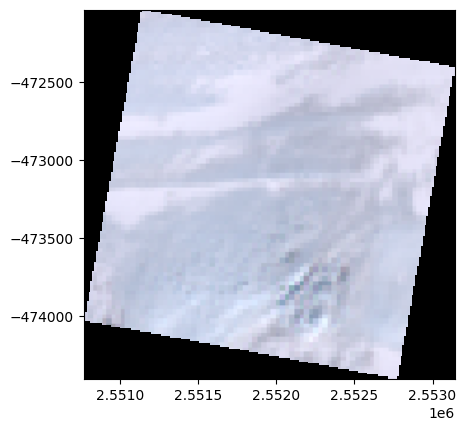

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


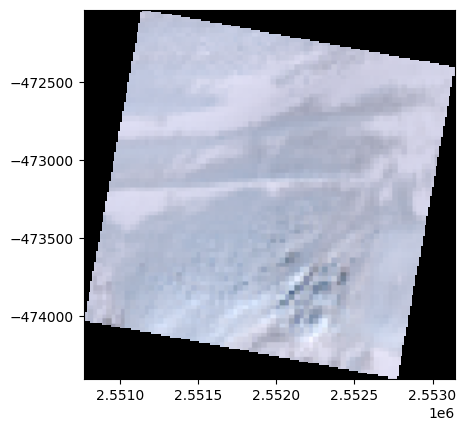

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


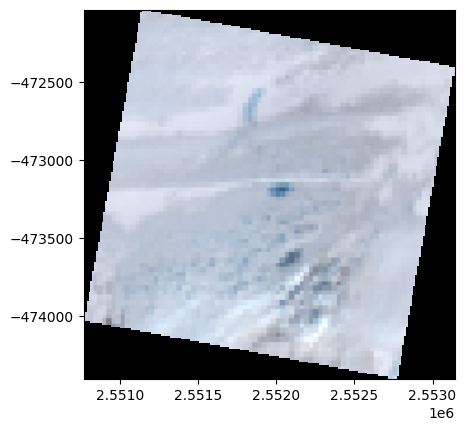

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


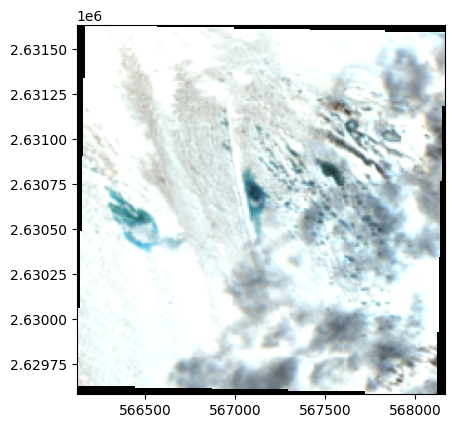

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


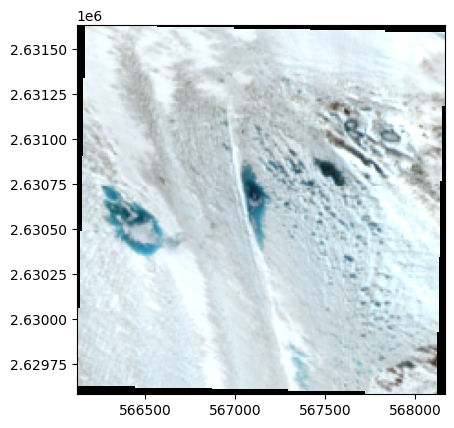

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


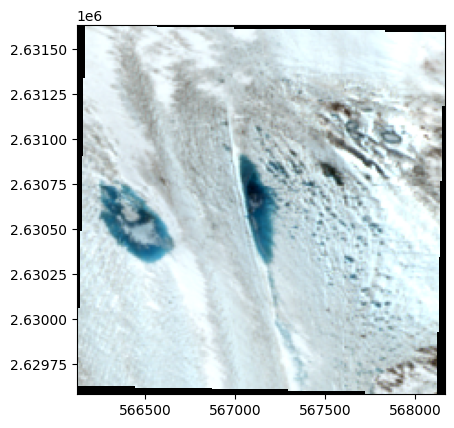

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


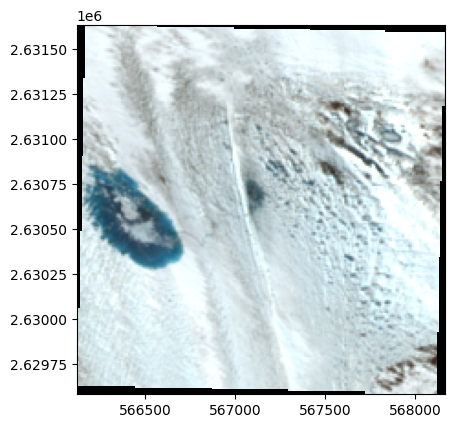

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


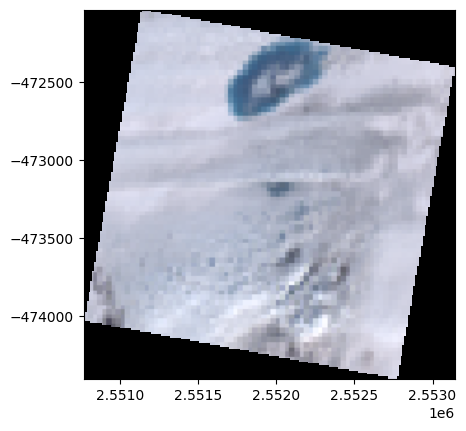

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


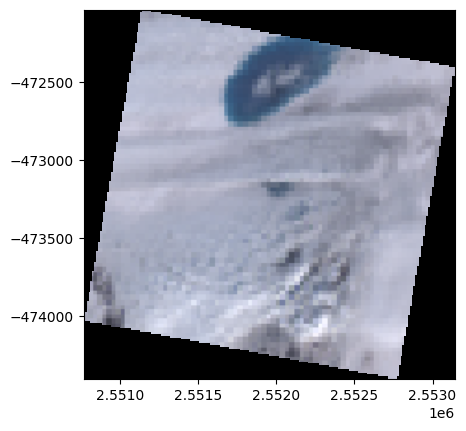

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


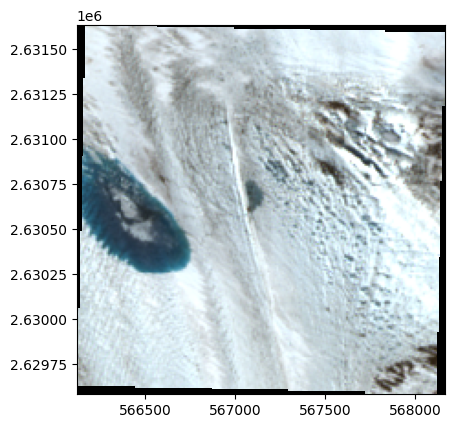

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


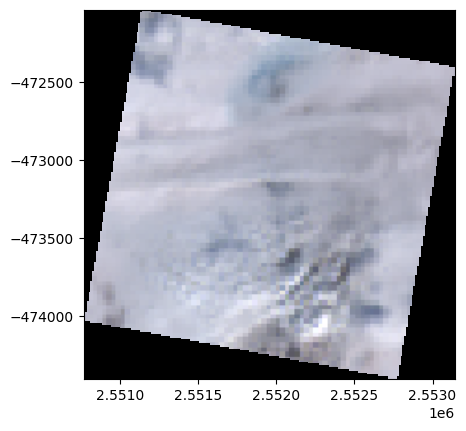

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


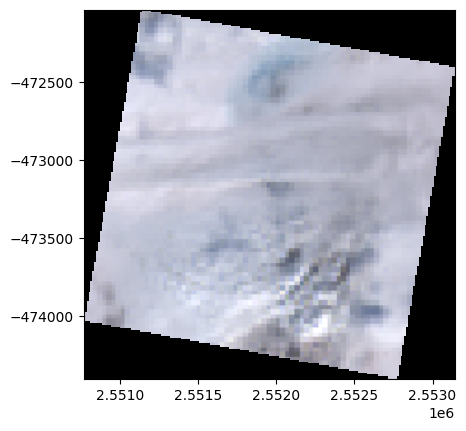

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


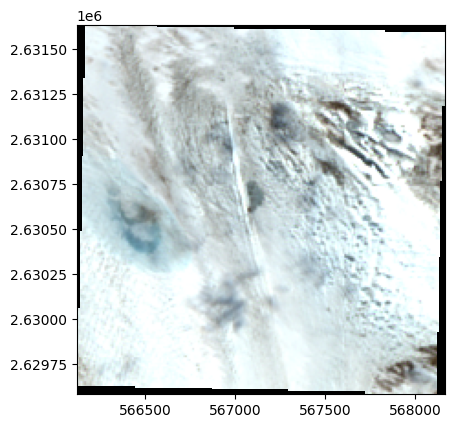

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


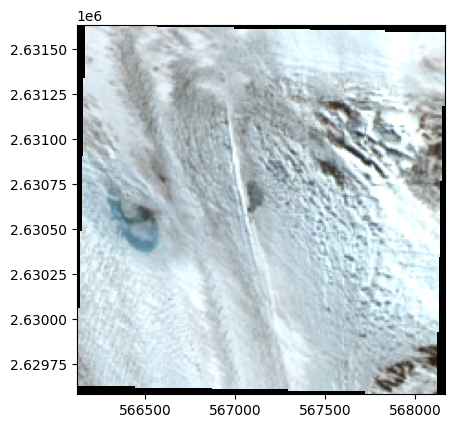

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


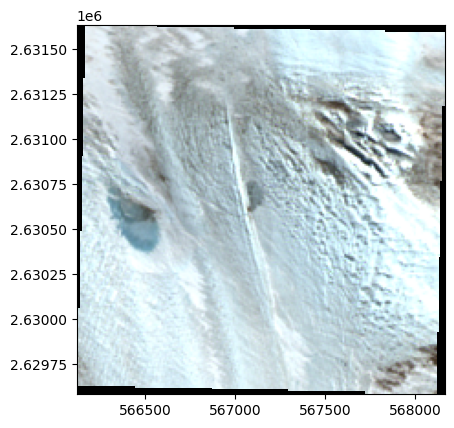

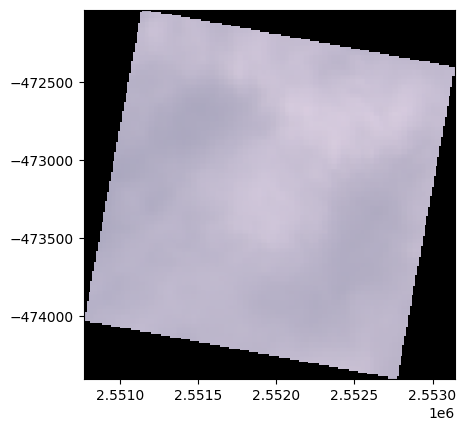

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


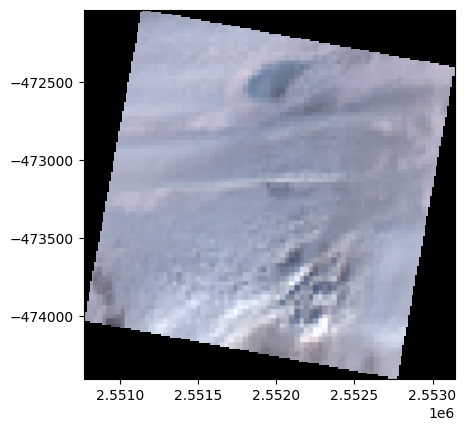

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


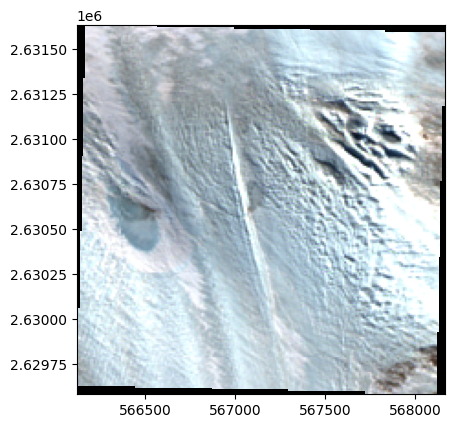

C:\Users\js-ms\AppData\Local\Temp\ipykernel_12716\1897323903.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  combined_event.sort_values("Timestamp", inplace=True)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019 Q


d:\[Code]\HydrofractureShackleton_2023\.venvASRP\Lib\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


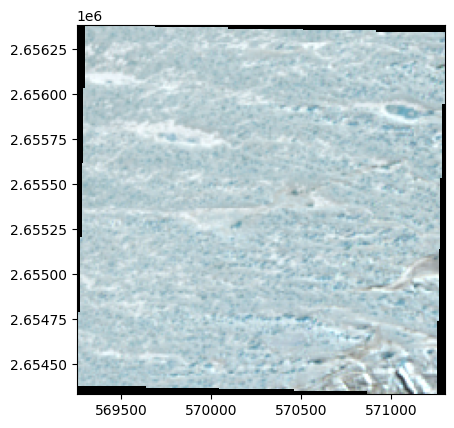

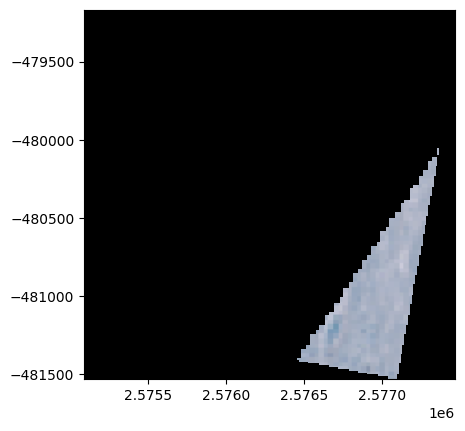

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


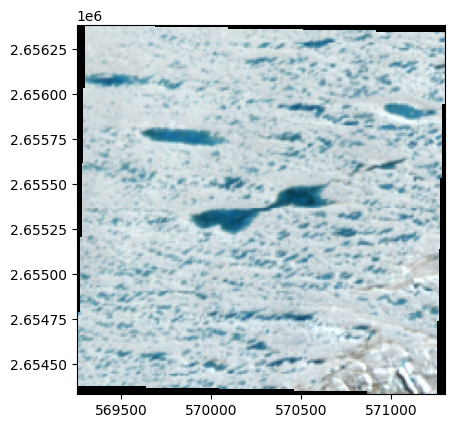

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


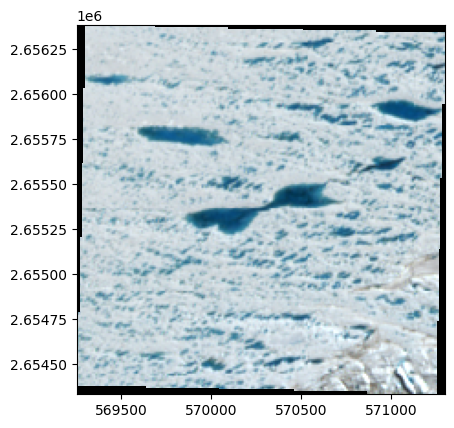

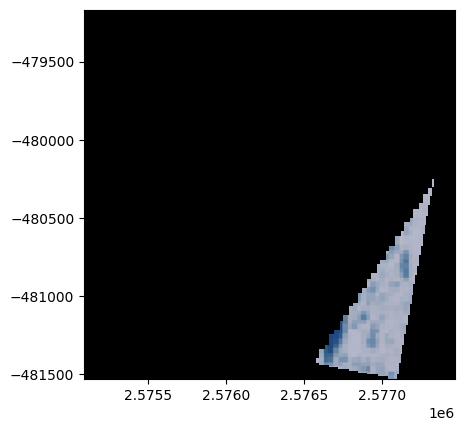

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


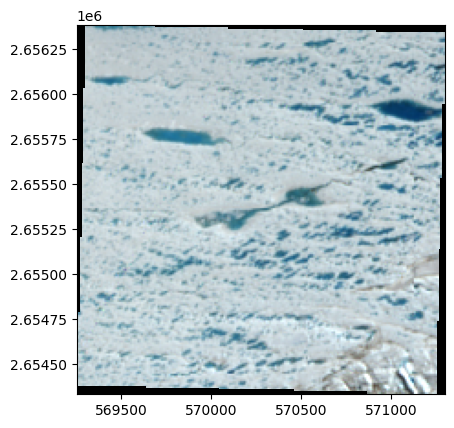

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


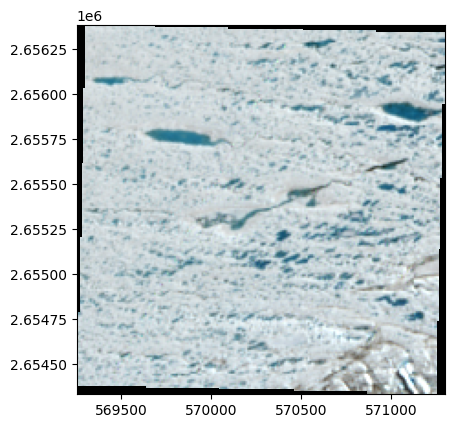

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


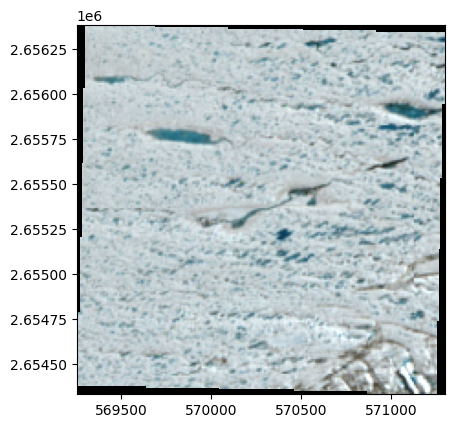

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


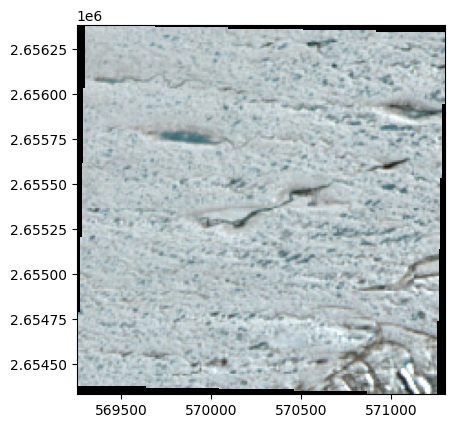

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


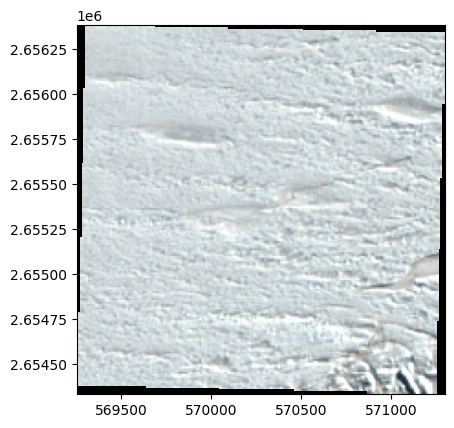

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


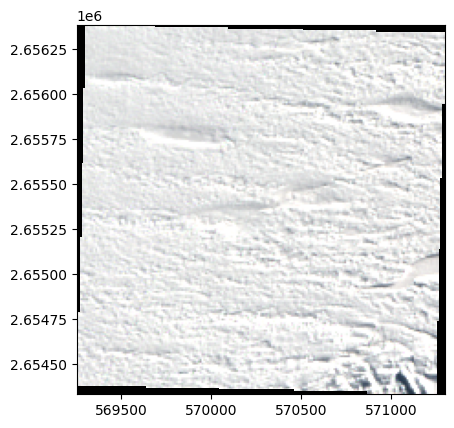

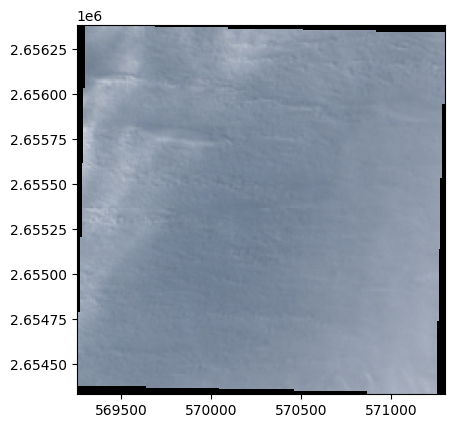

In [111]:
for summer in [2019]:
    combined_summer = combined.query(f"summer == {summer}")
    for i, label in enumerate(combined_summer["label"].unique()):
        print(summer, label)
        combined_event = combined_summer.query(f"label == '{label}'")
        combined_event.sort_values("Timestamp", inplace=True)

        for j, f in enumerate(combined_event["file"]):
            fig, ax = plt.subplots()
            with rasterio.open(os.path.join(data_img_folder, f)) as src:
                img = src.read()
                rplt.show(img, transform=src.transform)
            plt.show()